# Bee Disease detection using Machine Learning

# Kaggle Data installation


In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
from google.colab import files

files.upload() #this will prompt you to upload the kaggle.json

In [ ]:
!ls -lha kaggle.json
!pip install -q kaggle
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 /root/.kaggle/kaggle.json
!pwd
!kaggle datasets download -d jenny18/honey-bee-annotated-images
!unzip honey-bee-annotated-images.zip

Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
  inflating: bee_imgs/bee_imgs/003_250.png  
  inflating: bee_imgs/bee_imgs/003_251.png  
  inflating: bee_imgs/bee_imgs/003_252.png  
  inflating: bee_imgs/bee_imgs/003_253.png  
  inflating: bee_imgs/bee_imgs/003_254.png  
  inflating: bee_imgs/bee_imgs/003_255.png  
  inflating: bee_imgs/bee_imgs/003_256.png  
  inflating: bee_imgs/bee_imgs/003_257.png  
  inflating: bee_imgs/bee_imgs/003_258.png  
  inflating: bee_imgs/bee_imgs/003_259.png  
  inflating: bee_imgs/bee_imgs/003_260.png  
  inflating: bee_imgs/bee_imgs/003_261.png  
  inflating: bee_imgs/bee_imgs/003_262.png  
  inflating: bee_imgs/bee_imgs/003_263.png  
  inflating: bee_imgs/bee_imgs/003_264.png  
  inflating: bee_imgs/bee_imgs/003_265.png  
  inflating: bee_imgs/bee_imgs/003_266.png  
  inflating: bee_imgs/bee_imgs/003_267.png  
  inflating: bee_imgs/bee_imgs/003_268.png  
  inflating: bee_imgs/bee_imgs/003_269.png  
  inflating: bee_imgs/bee_imgs/003_

With the Kaggle data being imported we can begin the exploration of the data, the clean up etc.

# Libraries and functions

In [ ]:
%%capture
!pip install keras-tuner

In [ ]:
# @title libraries
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

import tensorflow as tf
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, Callback, TensorBoard
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Conv2D, MaxPooling2D, Flatten, Dropout, GlobalAveragePooling2D
from kerastuner.tuners import BayesianOptimization


import matplotlib.image as mpimg
import skimage.transform
from sklearn.model_selection import train_test_split
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

folder = '/content/bee_imgs/bee_imgs/'
img_width = 100
img_height = 100
img_channels = 3

<ipython-input-5-a278d72127ee>:10: DeprecationWarning: `import kerastuner` is deprecated, please use `import keras_tuner`.
  from kerastuner.tuners import BayesianOptimization


In [ ]:
# @title custom functions

def prepare_img(file):
  img = mpimg.imread(folder + file)
  img = skimage.transform.resize(img, (img_width, img_height), mode='reflect')
  return img[:,:,:img_channels]

def prepare2train(train_bees, val_bees, test_bees, field_name):
  """
  Load images for features, drop other columns
  One hot encode for label, drop other columns
  @return: image generator, train images, validation images, test images, train labels, validation labels, test labels
  """
  # Bees already splitted to train, validation and test
  # Load and transform images to have equal width/height/channels.
  # read_img function is defined in the beginning to use in both health and subspecies.
  # Use np.stack to get NumPy array for CNN input

  # Train data
  X_train = np.stack(train_bees['file'].apply(prepare_img))
  y_train  = pd.get_dummies(train_bees[field_name], drop_first=False)

  # Validation during training data to calc val_loss metric
  X_val = np.stack(val_bees['file'].apply(prepare_img))
  y_val = pd.get_dummies(val_bees[field_name], drop_first=False)

  # Test data
  X_test = np.stack(test_bees['file'].apply(prepare_img))
  y_test = pd.get_dummies(test_bees[field_name], drop_first=False)

  datagen = ImageDataGenerator(
      rotation_range=20,
      width_shift_range=0.2,
      height_shift_range=0.2,
      shear_range=0.2,
      zoom_range=0.2,
      horizontal_flip=True,
      fill_mode='nearest'
  )

  # Assume X_train and y_train are your training data and labels
  datagen.fit(X_train)

  return (datagen, X_train, X_val, X_test, y_train, y_val, y_test)

def build_model(base = None, dropout_rate = 0.2,fully_connected_neurons = 64, learn_rate = 0.001,model_name = 'model.keras'):
  input_shape = (img_height, img_width, img_channels)
  activation_func = 'relu'
  if base is not None:
    model = Sequential([
      base,
      MaxPooling2D(padding = 'same'),
      Flatten(),
      Dense(fully_connected_neurons, activation=activation_func),
      Dropout(dropout_rate),
      Dense(6, activation='softmax')])

  elif base == None:
    model = Sequential([
    Conv2D(32, (3, 3), activation=activation_func, input_shape=(img_height, img_width, img_channels)),
    MaxPooling2D((2, 2)),
    Conv2D(64, (3, 3), activation=activation_func),
    MaxPooling2D((2, 2)),
    Flatten(),
    Dense(fully_connected_neurons, activation=activation_func),
    Dropout(dropout_rate),
    Dense(6, activation='softmax')])

  model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=learn_rate),
                loss=tf.keras.losses.CategoricalCrossentropy(),
                metrics=['accuracy', F1Score()])

  model_callbacks = [
  ModelCheckpoint(filepath=model_name,
                  save_best_only=True,
                  monitor='val_loss',
                  verbose=1),
  EarlyStopping(monitor='val_loss',
                patience=10,
                verbose=1)]
  return(model, model_callbacks)

  # Plot the training history
def plot_training_history(history, subtitle):
    # Get the history dictionary
    hist = history.history

    # Get the list of epochs
    epochs = range(len(hist['loss']))

    # Plot training and validation loss
    plt.figure(figsize=(18, 6))
    plt.subplot(1, 3, 1)
    plt.plot(epochs, hist['loss'], label='Training Loss')
    plt.plot(epochs, hist['val_loss'], label='Validation Loss')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    # Plot training and validation accuracy
    plt.subplot(1, 3, 2)
    plt.plot(epochs, hist['accuracy'], label='Training Accuracy')
    plt.plot(epochs, hist['val_accuracy'], label='Validation Accuracy')
    plt.title('Training and Validation Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()

    # Plot training and validation F1 Score
    plt.subplot(1, 3, 3)
    plt.plot(epochs, hist['f1_score'], label='Training F1 Score')
    plt.plot(epochs, hist['val_f1_score'], label='Validation F1 Score')
    plt.title('Training and Validation F1 Score')
    plt.xlabel('Epochs')
    plt.ylabel('F1 Score')
    plt.legend()

    plt.suptitle(subtitle)
    # Show the plots
    plt.tight_layout()
    plt.show()

def model_evaluation(X_test, y_test, model = None, path_to_model = None):
    # Load your trained model

    if model is None and path_to_model is None:
      print("No model provided")
      return
    if path_to_model is not None:
      model = tf.keras.models.load_model(path_to_model, custom_objects={'F1Score': F1Score})

    # Evaluate the model on the test set
    test_loss, test_accuracy, test_f1_score = model.evaluate(X_test, y_test, verbose=1)

    print(f'Test loss: {test_loss}')
    print(f'Test accuracy: {test_accuracy}')
    print(f'Test F1 score: {test_f1_score}')

    # Make predictions on the test set
    predictions = model.predict(X_test)

    # If using categorical crossentropy, convert predictions to class labels
    predicted_classes = np.argmax(predictions, axis=1)
    true_classes = np.argmax(y_test, axis=1)

    print(f'Predicted classes: {predicted_classes}')
    print(f'True classes: {true_classes}')

    conf_matrix = confusion_matrix(true_classes, predicted_classes)
    print('Confusion Matrix:')

    labels = ['Varroa, Hive beetles', 'Ant Problem', 'few varrao, small hive beetles', 'healthy', 'Hive being robbed', 'Missing Queen']
    disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix, display_labels=labels)
    disp.plot(cmap=plt.cm.Blues, values_format='d')
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.xticks(rotation=90)
    plt.show()

class F1Score(tf.keras.metrics.Metric):
  def __init__(self, name='f1_score', **kwargs):
    super(F1Score, self).__init__(name=name, **kwargs)
    self.true_positives = self.add_weight(name='tp', initializer='zeros')
    self.false_positives = self.add_weight(name='fp', initializer='zeros')
    self.false_negatives = self.add_weight(name='fn', initializer='zeros')

  def update_state(self, y_true, y_pred, sample_weight=None):
    y_true = tf.cast(y_true, tf.float32)
    y_pred = tf.cast(tf.round(y_pred), tf.float32)

    tp = tf.reduce_sum(tf.cast(y_true * y_pred, 'float32'))
    fp = tf.reduce_sum(tf.cast((1 - y_true) * y_pred, 'float32'))
    fn = tf.reduce_sum(tf.cast(y_true * (1 - y_pred), 'float32'))

    self.true_positives.assign_add(tp)
    self.false_positives.assign_add(fp)
    self.false_negatives.assign_add(fn)

  def result(self):
    precision = self.true_positives / (self.true_positives + self.false_positives + tf.keras.backend.epsilon())
    recall = self.true_positives / (self.true_positives + self.false_negatives + tf.keras.backend.epsilon())
    f1_score = 2 * ((precision * recall) / (precision + recall + tf.keras.backend.epsilon()))
    return f1_score

  def reset_state(self):
    self.true_positives.assign(0)
    self.false_positives.assign(0)
    self.false_negatives.assign(0)


# Exploratory Data Analysis

In [ ]:
data = pd.read_csv('bee_data.csv',
                dtype={'subspecies':'category', 'health':'category','caste':'category'})
data.head()

,file,date,time,location,zip code,subspecies,health,pollen_carrying,caste
0,041_066.png,8/28/18,16:07,"Alvin, TX, USA",77511,-1,hive being robbed,False,worker
1,041_072.png,8/28/18,16:07,"Alvin, TX, USA",77511,-1,hive being robbed,False,worker
2,041_073.png,8/28/18,16:07,"Alvin, TX, USA",77511,-1,hive being robbed,False,worker
3,041_067.png,8/28/18,16:07,"Alvin, TX, USA",77511,-1,hive being robbed,False,worker
4,041_059.png,8/28/18,16:07,"Alvin, TX, USA",77511,-1,hive being robbed,False,worker


## Plots and visualisation

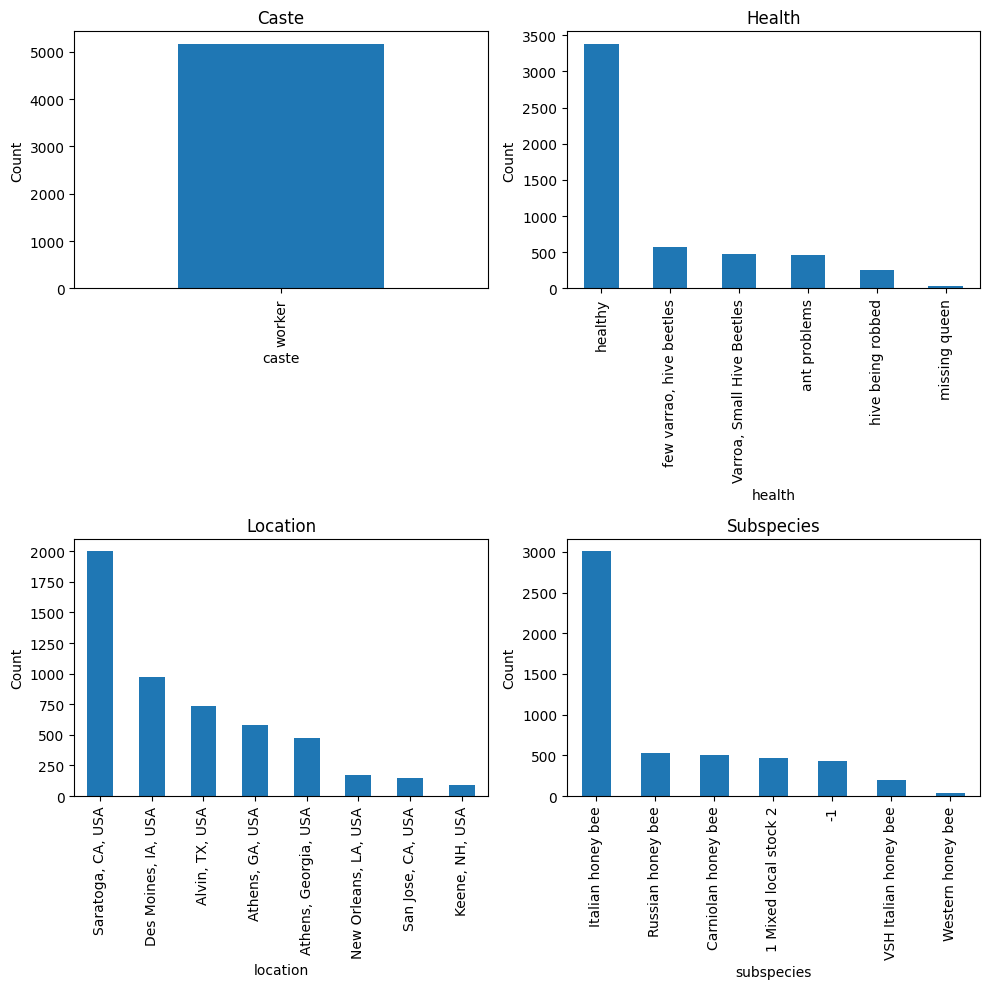

In [ ]:
figure, axes = plt.subplots(figsize=(10,10),nrows=2,ncols=2)

data['caste'].value_counts().plot(kind='bar',ax=axes[0,0])
axes[0,0].set_title('Caste')
axes[0,0].set_ylabel('Count')

data['health'].value_counts().plot(kind='bar',ax=axes[0,1])
axes[0,1].set_title('Health')
axes[0,1].set_ylabel('Count')

data['location'].value_counts().plot(kind='bar',ax=axes[1,0])
axes[1,0].set_title('Location')
axes[1,0].set_ylabel('Count')

data['subspecies'].value_counts().plot(kind='bar',ax=axes[1,1])
axes[1,1].set_title('Subspecies')
axes[1,1].set_ylabel('Count')

figure.subplots_adjust(hspace=0.5)
figure.tight_layout()

plt.show()

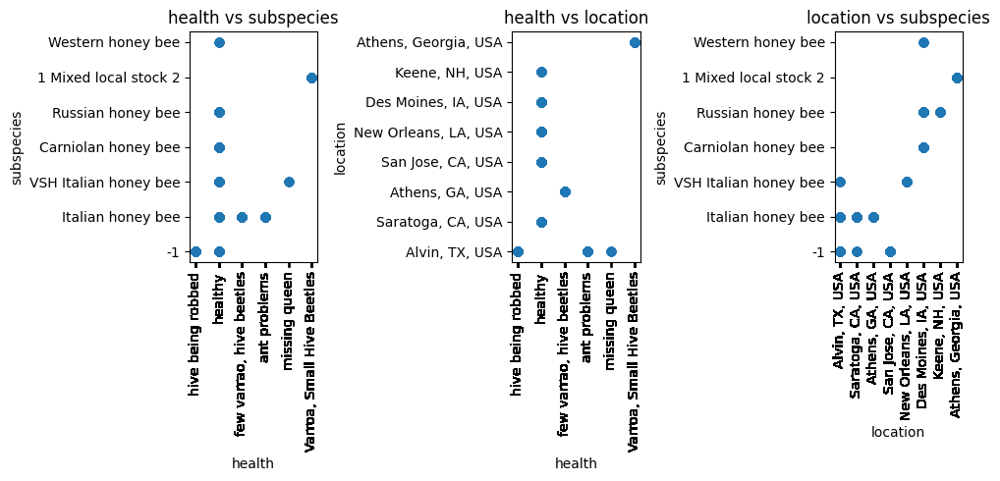

In [ ]:
### visualization
fig, axs = plt.subplots(1, 3, figsize=(10, 5))

axs[0].scatter(data['health'],data['subspecies'])
axs[0].set_xticks(data['health'])
axs[0].tick_params(axis='x', rotation=90)
axs[0].set_title('health vs subspecies')
axs[0].set_xlabel('health')
axs[0].set_ylabel('subspecies')

axs[1].scatter(data['health'],data['location'])
axs[1].set_xticks(data['health'])
axs[1].tick_params(axis='x', rotation=90)
axs[1].set_title('health vs location')
axs[1].set_xlabel('health')
axs[1].set_ylabel('location')

axs[2].scatter(data['location'],data['subspecies'])
axs[2].set_xticks(data['location'])
axs[2].tick_params(axis='x', rotation=90)
axs[2].set_title('location vs subspecies')
axs[2].set_xlabel('location')
axs[2].set_ylabel('subspecies')

fig.subplots_adjust(hspace=0.5)
fig.tight_layout()
plt.show()

## image visualisation

No we print some images to see potential images of the bees

In [ ]:
max = 0
max_shape = []
min = np.inf
min_shape = []
for i in range(len(data['file'])):
  img = mpimg.imread(folder + data['file'][i])
  res = img.shape[0] * img.shape[1]
  if res < min:
    min = res
    min_shape = img.shape

  if res > max:
    max = res
    max_shape = img.shape

print("max shape: " + str(max_shape))
print("min shape: " + str(min_shape))



max shape: (473, 392, 3)
min shape: (31, 35, 3)


In [ ]:
img = mpimg.imread(folder + data['file'][0])
img.shape


(115, 164, 3)

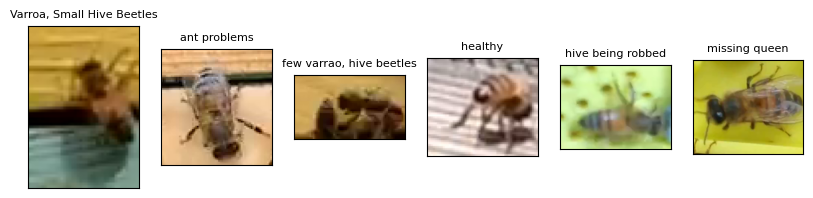

In [ ]:
health_conditions = data['health'].cat.categories

fig, axs = plt.subplots(1, health_conditions.size, figsize=(10, 5))
i = 0
for condition in health_conditions:
    bee = data[data['health'] == condition].sample(1).iloc[0]
    file = bee['file']
    path = folder + file
    axs[i].imshow(mpimg.imread(folder + bee[0]))
    axs[i].set_title(bee['health'],fontsize = 8)
    axs[i].set_xticks([])
    axs[i].set_yticks([])
    i += 1

plt.show()

# UNBALANCED DATA EXPERIMENTS

now we will to the unbalanced approach and test how it affects the models and the learning of them. First we begin to divide data into train,validation and test sets

In [ ]:
train_bees , test_bees = train_test_split(data, test_size= 0.2, stratify=data['health'])
train_bees , val_bees = train_test_split(train_bees, test_size= 0.1, stratify= train_bees['health'])

In [ ]:
X_train = np.stack(train_bees['file'].apply(prepare_img))
y_train = pd.get_dummies(train_bees['health'], drop_first=False)

X_val = np.stack(val_bees['file'].apply(prepare_img))
y_val = pd.get_dummies(val_bees['health'], drop_first=False)

X_test = np.stack(test_bees['file'].apply(prepare_img))
y_test = pd.get_dummies(test_bees['health'], drop_first=False)

In [ ]:
print(X_train.shape)

(3723, 100, 100, 3)


# model selection

first we begin by makin simple CNN

## Simple CNN

In [ ]:
mymodel, mymodel_callbacks = build_model(dropout_rate= 0.5, model_name='simple_model.keras')

/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [ ]:
myhistory = mymodel.fit(
            X_train,y_train,
            epochs=50,
            batch_size=32,
            validation_data=(X_val,y_val),
            callbacks=mymodel_callbacks,
            verbose=1)

Epoch 1/50
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - accuracy: 0.6291 - f1_score: 0.5474 - loss: 1.1612
Epoch 1: val_loss improved from inf to 0.50253, saving model to simple_model.keras
117/117 ━━━━━━━━━━━━━━━━━━━━ 8s 49ms/step - accuracy: 0.6295 - f1_score: 0.5482 - loss: 1.1593 - val_accuracy: 0.7899 - val_f1_score: 0.7929 - val_loss: 0.5025
Epoch 2/50
115/117 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.7805 - f1_score: 0.7813 - loss: 0.5567
Epoch 2: val_loss improved from 0.50253 to 0.37125, saving model to simple_model.keras
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 0.7809 - f1_score: 0.7814 - loss: 0.5562 - val_accuracy: 0.8551 - val_f1_score: 0.8411 - val_loss: 0.3712
Epoch 3/50
116/117 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.8253 - f1_score: 0.8254 - loss: 0.4258
Epoch 3: val_loss did not improve from 0.37125
117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.8254 - f1_score: 0.8255 - loss: 0.4255 - val_accuracy: 0.8502 - val_f1_score: 0.8498 - va

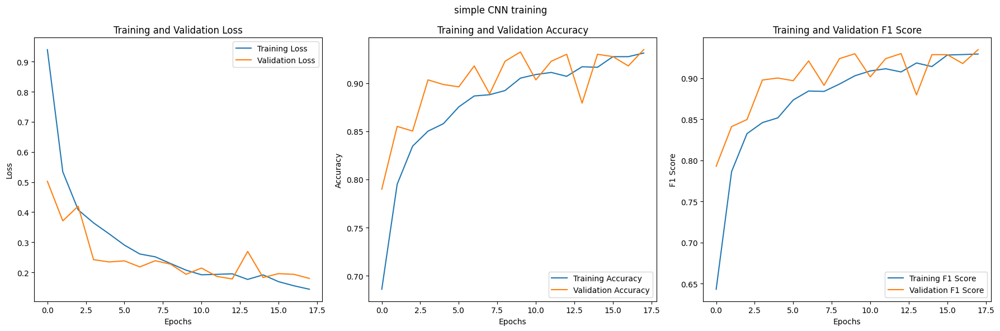

In [ ]:
plot_training_history(myhistory, "simple CNN training")

33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 25ms/step - accuracy: 0.9229 - f1_score: 0.9231 - loss: 0.1856
Test loss: 0.18428340554237366
Test accuracy: 0.9207729697227478
Test F1 score: 0.9201740622520447
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Predicted classes: [3 3 2 ... 1 3 2]
True classes: [3 3 2 ... 1 3 2]
Confusion Matrix:


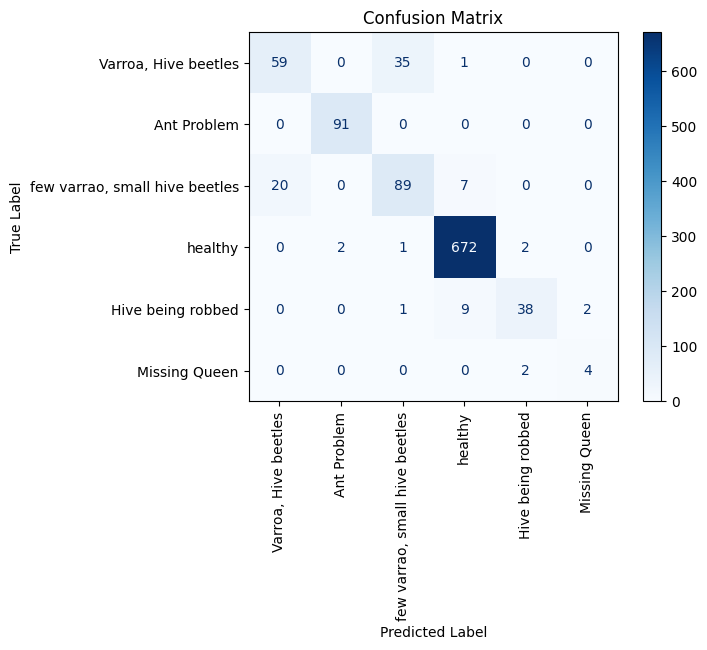

In [ ]:
model_evaluation(X_test,y_test,"simple_model.keras")

## MobilenetV2

In [ ]:
input_shape = (img_height, img_width, img_channels)

mobilenet_base = tf.keras.applications.MobileNetV2(weights='imagenet', include_top=False, input_shape=input_shape)
mobilenet_base.trainable = False

mobile_model, mobile_callbacks = build_model(base=mobilenet_base,dropout_rate=0.5, model_name='Mobile_model.keras')

<ipython-input-30-6ad6f51701f6>:3: UserWarning: `input_shape` is undefined or non-square, or `rows` is not in [96, 128, 160, 192, 224]. Weights for input shape (224, 224) will be loaded as the default.
  mobilenet_base = tf.keras.applications.MobileNetV2(input_shape=input_shape, include_top=False, weights='imagenet')


In [ ]:
mobile_history = mobile_model.fit(X_train, y_train,
                                  validation_data=(X_val, y_val),
                                  epochs=10,
                                  callbacks=mobile_callbacks,
                                  verbose=1)

Epoch 1/10
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step - accuracy: 0.5568 - f1_score: 0.4836 - loss: 1.7954
Epoch 1: val_loss improved from inf to 0.59423, saving model to Mobile_model.keras
117/117 ━━━━━━━━━━━━━━━━━━━━ 18s 98ms/step - accuracy: 0.5575 - f1_score: 0.4843 - loss: 1.7903 - val_accuracy: 0.7729 - val_f1_score: 0.7584 - val_loss: 0.5942
Epoch 2/10
114/117 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - accuracy: 0.7142 - f1_score: 0.6734 - loss: 0.8140
Epoch 2: val_loss improved from 0.59423 to 0.49691, saving model to Mobile_model.keras
117/117 ━━━━━━━━━━━━━━━━━━━━ 9s 15ms/step - accuracy: 0.7147 - f1_score: 0.6742 - loss: 0.8123 - val_accuracy: 0.7923 - val_f1_score: 0.7907 - val_loss: 0.4969
Epoch 3/10
112/117 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - accuracy: 0.7380 - f1_score: 0.7339 - loss: 0.6643
Epoch 3: val_loss improved from 0.49691 to 0.45568, saving model to Mobile_model.keras
117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - accuracy: 0.7378 - f1_score: 0.7338 - loss: 0.6639 - val_accu

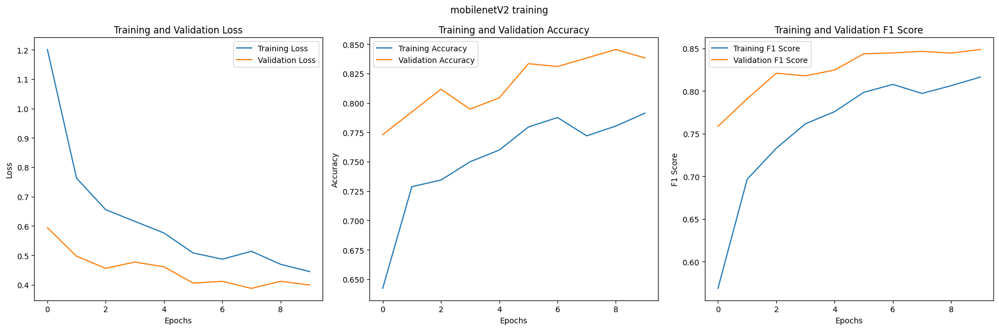

ValueError: Exception encountered when calling MaxPooling2D.call().

[1moperands could not be broadcast together with shapes (0,4) (2,) [0m

Arguments received by MaxPooling2D.call():
  • args=(['<KerasTensor shape=(None, 4, 4, 1280), dtype=float32, sparse=False, name=keras_tensor_2371>'],)
  • kwargs=<class 'inspect._empty'>

In [ ]:
plot_training_history(mobile_history,"mobilenetV2 training")
model_evaluation(X_test,y_test,'Mobile_model.keras')

## VGG 16

In [ ]:
vgg16_base = tf.keras.applications.VGG16(weights='imagenet', include_top=False, input_shape=input_shape)
vgg16_base.trainable = False

vgg16_model, vgg16_callbacks = build_model(base=vgg16_base, dropout_rate=0.5, model_name='vgg16_model.keras')

vgg16_history = vgg16_model.fit(X_train,y_train,
                                validation_data=(X_val,y_val),
                                epochs=50,
                                batch_size=32,
                                callbacks=vgg16_callbacks,
                                verbose=1)

58889256/58889256 [==============================] - 0s 0us/step
Epoch 1/50
117/117 [==============================] - ETA: 0s - loss: 1.0958 - accuracy: 0.6441 - f1_score: 0.5856
Epoch 1: val_loss improved from inf to 0.74937, saving model to vgg16_model.keras
117/117 [==============================] - 11s 67ms/step - loss: 1.0958 - accuracy: 0.6441 - f1_score: 0.5856 - val_loss: 0.7494 - val_accuracy: 0.6884 - val_f1_score: 0.7059
Epoch 2/50
116/117 [============================>.] - ETA: 0s - loss: 0.7549 - accuracy: 0.7309 - f1_score: 0.7125
Epoch 2: val_loss improved from 0.74937 to 0.59317, saving model to vgg16_model.keras
117/117 [==============================] - 6s 49ms/step - loss: 0.7542 - accuracy: 0.7311 - f1_score: 0.7129 - val_loss: 0.5932 - val_accuracy: 0.7415 - val_f1_score: 0.7548
Epoch 3/50
117/117 [==============================] - ETA: 0s - loss: 0.6052 - accuracy: 0.7776 - f1_score: 0.7695
Epoch 3: val_loss improved from 0.59317 to 0.47926, saving model to vgg16

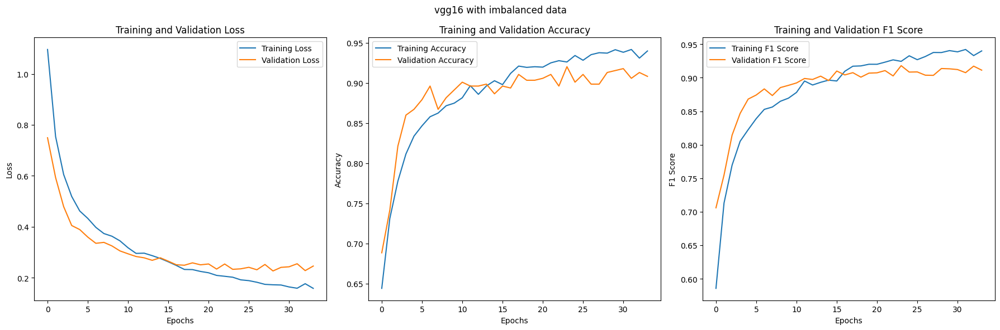

33/33 [==============================] - 2s 34ms/step - loss: 0.2694 - accuracy: 0.9005 - f1_score: 0.9016
Test loss: 0.2694399356842041
Test accuracy: 0.9004830718040466
Test F1 score: 0.9015593528747559
33/33 [==============================] - 1s 31ms/step
Predicted classes: [0 0 1 ... 4 1 4]
True classes: [0 0 1 ... 4 1 4]
Confusion Matrix:


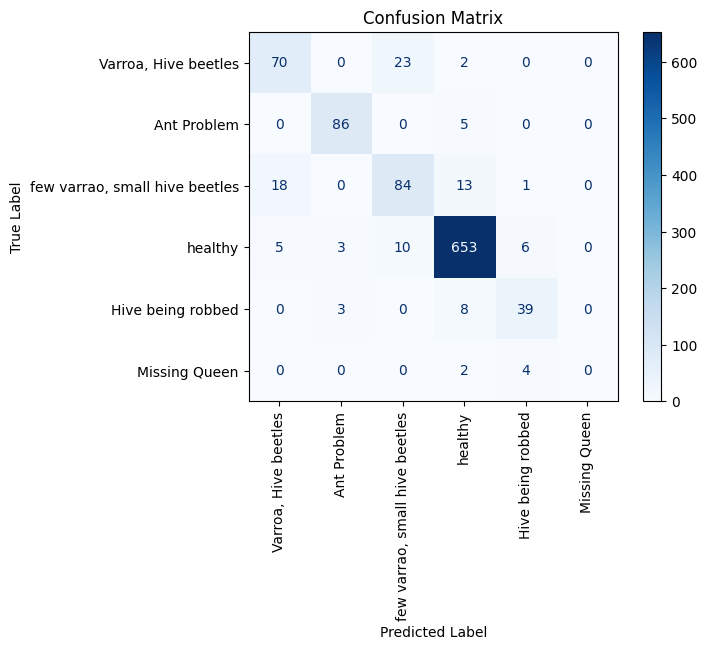

In [ ]:
plot_training_history(vgg16_history,"vgg16 with imbalanced data")
model_evaluation(X_test,y_test,'vgg16_model.keras')

## ResNet 50

In [ ]:
resnet_base = tf.keras.applications.ResNet50(weights='imagenet', include_top=False, input_shape=input_shape)
resnet_base.trainable = False

resnet_model, resnet_callbacks = build_model(base = resnet_base, dropout_rate=0.5, model_name='resnet_model.keras')

resnet_history = resnet_model.fit(X_train,y_train,
                                validation_data=(X_val,y_val),
                                epochs=50,
                                batch_size=32,
                                callbacks=resnet_callbacks,
                                verbose=1)

94765736/94765736 [==============================] - 1s 0us/step
Epoch 1/50
117/117 [==============================] - ETA: 0s - loss: 1.5955 - accuracy: 0.6148 - f1_score: 0.3877
Epoch 1: val_loss improved from inf to 1.31923, saving model to resnet_model.keras
117/117 [==============================] - 16s 77ms/step - loss: 1.5955 - accuracy: 0.6148 - f1_score: 0.3877 - val_loss: 1.3192 - val_accuracy: 0.6546 - val_f1_score: 0.0000e+00
Epoch 2/50
117/117 [==============================] - ETA: 0s - loss: 1.3916 - accuracy: 0.6538 - f1_score: 0.4358
Epoch 2: val_loss improved from 1.31923 to 1.23333, saving model to resnet_model.keras
117/117 [==============================] - 5s 46ms/step - loss: 1.3916 - accuracy: 0.6538 - f1_score: 0.4358 - val_loss: 1.2333 - val_accuracy: 0.6546 - val_f1_score: 0.0000e+00
Epoch 3/50
115/117 [============================>.] - ETA: 0s - loss: 1.3458 - accuracy: 0.6535 - f1_score: 0.4275
Epoch 3: val_loss improved from 1.23333 to 1.11394, saving mode

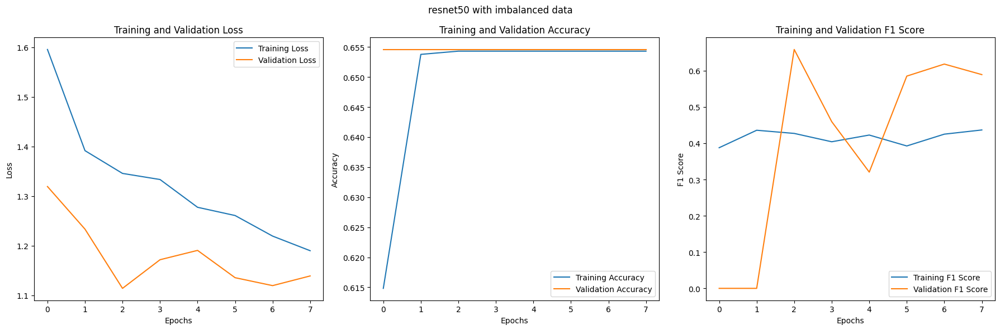

33/33 [==============================] - 3s 30ms/step - loss: 1.1195 - accuracy: 0.6541 - f1_score: 0.6534
Test loss: 1.1194634437561035
Test accuracy: 0.6541062593460083
Test F1 score: 0.6533786058425903
33/33 [==============================] - 2s 28ms/step
Predicted classes: [3 3 3 ... 3 3 3]
True classes: [0 0 1 ... 4 1 4]
Confusion Matrix:


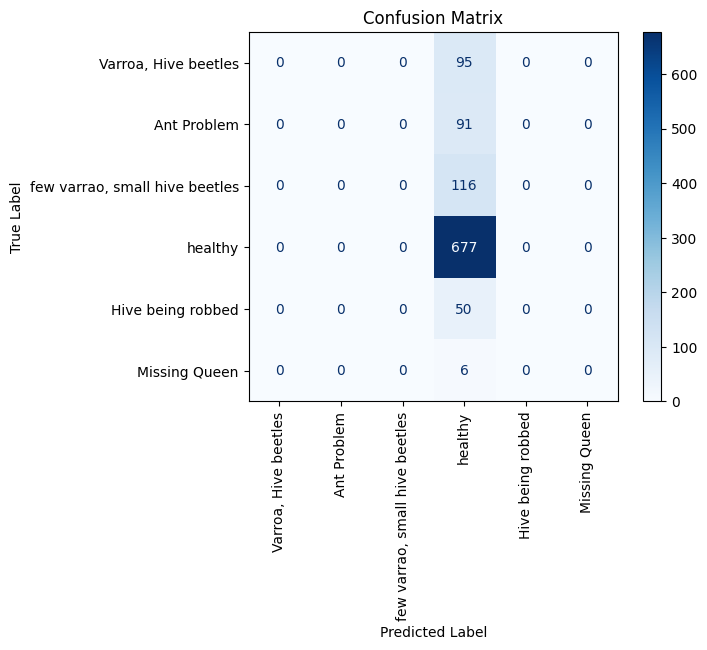

In [ ]:
plot_training_history(resnet_history,"resnet50 with imbalanced data")
model_evaluation(X_test,y_test,'resnet_model.keras')

## Efficient Net

In [ ]:
efficient_base = tf.keras.applications.EfficientNetB0(weights='imagenet', include_top=False, input_shape=input_shape)
efficient_base.trainable = False

efficient_model, efficient_callbacks = build_model(base = efficient_base, dropout_rate=0.5, model_name='efficient_model.keras')

efficient_history = efficient_model.fit(X_train,y_train,
                                validation_data=(X_val,y_val),
                                epochs=50,
                                batch_size=32,
                                callbacks=efficient_callbacks,
                                verbose=1)

16705208/16705208 [==============================] - 0s 0us/step
Epoch 1/50
115/117 [============================>.] - ETA: 0s - loss: 1.3752 - accuracy: 0.6323 - f1_score: 0.4455
Epoch 1: val_loss improved from inf to 1.21157, saving model to efficient_model.keras
117/117 [==============================] - 14s 56ms/step - loss: 1.3773 - accuracy: 0.6317 - f1_score: 0.4450 - val_loss: 1.2116 - val_accuracy: 0.6546 - val_f1_score: 0.0000e+00
Epoch 2/50
115/117 [============================>.] - ETA: 0s - loss: 1.2969 - accuracy: 0.6527 - f1_score: 0.4634
Epoch 2: val_loss improved from 1.21157 to 1.13860, saving model to efficient_model.keras
117/117 [==============================] - 3s 28ms/step - loss: 1.2944 - accuracy: 0.6543 - f1_score: 0.4650 - val_loss: 1.1386 - val_accuracy: 0.6546 - val_f1_score: 0.6546
Epoch 3/50
115/117 [============================>.] - ETA: 0s - loss: 1.2669 - accuracy: 0.6546 - f1_score: 0.4722
Epoch 3: val_loss did not improve from 1.13860
117/117 [=====

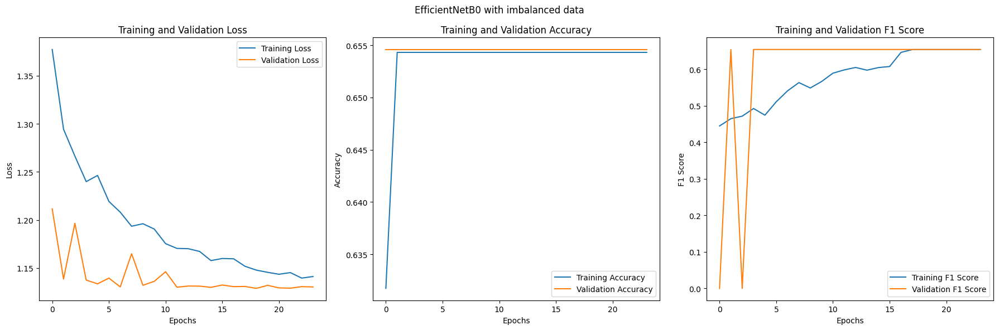

33/33 [==============================] - 4s 43ms/step - loss: 1.1328 - accuracy: 0.6541 - f1_score: 0.6541
Test loss: 1.1327663660049438
Test accuracy: 0.6541062593460083
Test F1 score: 0.6541061997413635
33/33 [==============================] - 2s 18ms/step
Predicted classes: [3 3 3 ... 3 3 3]
True classes: [0 0 1 ... 4 1 4]
Confusion Matrix:


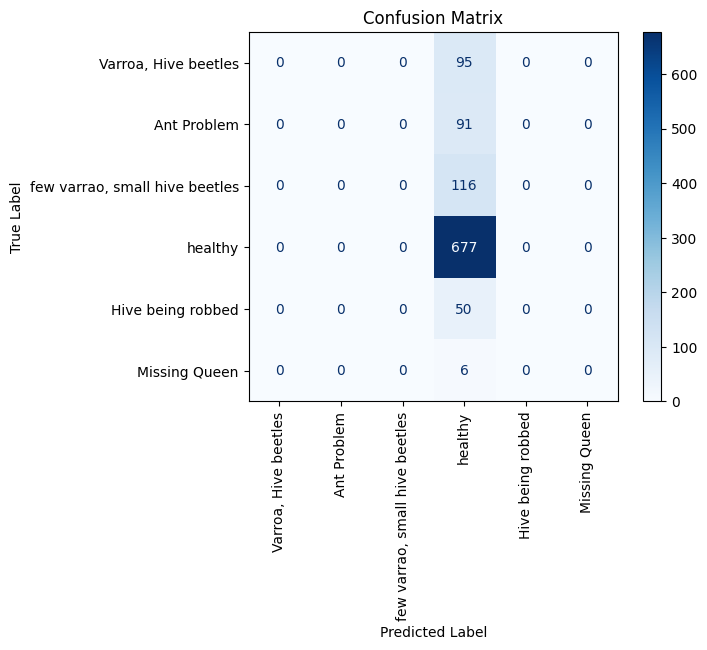

In [ ]:
plot_training_history(efficient_history,"EfficientNetB0 with imbalanced data")
model_evaluation(X_test,y_test,'efficient_model.keras')

# Hyperparameter tuning

The Bayesian Optimisation will be used from the keras_tuner library, in order to perform it, the build model function have to be adjusted.

In [ ]:
# @title build_model function adjcustment

def hyper_model(hp):
    input_shape = (img_height, img_width, img_channels)

    dropout_rate = hp.Float('dropout_rate', min_value=0.0, max_value=0.5, step=0.05)
    fully_connected_neurons = hp.Int('fully_connected_neurons', min_value=32, max_value=256, step=32)
    learn_rate = hp.Float('learn_rate', min_value=1e-4, max_value=1e-2, sampling='LOG')
    activation_func = 'relu'

    base = resnet_base #change to different bases
    model = Sequential([
        base,
        #Conv2D(32, (3, 3), activation=activation_func, input_shape=(img_height, img_width, img_channels)),
        #MaxPooling2D((2, 2)),
       # Conv2D(64, (3, 3), activation=activation_func),
        MaxPooling2D(),
        Flatten(),
        Dense(fully_connected_neurons, activation=activation_func),
        Dropout(dropout_rate),
        Dense(6, activation='softmax')
    ])


    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=learn_rate),
                  loss=tf.keras.losses.CategoricalCrossentropy(),
                  metrics=['accuracy', F1Score()])

    return model

def model_builder(hp):
    return hyper_model(hp)



In [ ]:
def hyper_plotting(data, subtitle):
    # Get the list of epochs
    epochs = range(len(data['loss']))

    # Plot training and validation loss
    plt.figure(figsize=(18, 6))
    plt.subplot(1, 3, 1)
    plt.plot(epochs, data['loss'], label='Training Loss')
    plt.plot(epochs, data['val_loss'], label='Validation Loss')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    # Plot training and validation accuracy
    plt.subplot(1, 3, 2)
    plt.plot(epochs, data['accuracy'], label='Training Accuracy')
    plt.plot(epochs, data['val_accuracy'], label='Validation Accuracy')
    plt.title('Training and Validation Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()

    # Plot training and validation F1 Score
    plt.subplot(1, 3, 3)
    plt.plot(epochs, data['f1_score'], label='Training F1 Score')
    plt.plot(epochs, data['val_f1_score'], label='Validation F1 Score')
    plt.title('Training and Validation F1 Score')
    plt.xlabel('Epochs')
    plt.ylabel('F1 Score')
    plt.legend()

    plt.suptitle(subtitle)
    # Show the plots
    plt.tight_layout()
    plt.show()

In [ ]:

def tuner_builder(trial_location = 'trial_location', csv_name = 'hypermodel_tuned.csv', model_name = 'hypermodel_tuned.keras'):

  tuner = BayesianOptimization(
      model_builder,
      objective='val_loss',
      max_trials=20,
      executions_per_trial=1,
      directory='/content/',
      overwrite=True,
      project_name=trial_location
  )

  # Define the callbacks
  model_callbacks = [
      ModelCheckpoint(filepath=model_name, save_best_only=True, monitor='val_loss', verbose=1),
      EarlyStopping(monitor='val_loss', patience=5, verbose=1),
      TensorBoard("/tmp/tb_logs")
  ]
  return tuner, model_callbacks

## Simple CNN

In [ ]:
simple_tuner, simple_tuner_callbacks = tuner_builder('simple','simple.csv','simple_tuned.keras')

# Search for the best hyperparameters
simple_tuner.search(X_train, y_train, epochs=20, validation_data=(X_val, y_val), callbacks=simple_tuner_callbacks)

# Get the best model
best_model = simple_tuner.get_best_models(num_models=1)[0]

# Save the best model
best_model.save('simple_the_best_model.keras')

Trial 20 Complete [00h 00m 54s]
val_loss: 0.1702650636434555

Best val_loss So Far: 0.14313791692256927
Total elapsed time: 00h 20m 30s


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.10/dist-packages/keras/src/saving/saving_lib.py:576: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


In [ ]:
best_parameters = simple_tuner.get_best_hyperparameters()[0]
print(best_parameters.values)

{'dropout_rate': 0.2, 'fully_connected_neurons': 160, 'learn_rate': 0.000460281171997864}


In [ ]:
%load_ext tensorboard

%tensorboard --logdir /tmp/tb_logs

<IPython.core.display.Javascript object>

/usr/local/lib/python3.10/dist-packages/keras/src/saving/saving_lib.py:576: UserWarning: Skipping variable loading for optimizer 'adam', because it has 18 variables whereas the saved optimizer has 2 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 28ms/step - accuracy: 0.9514 - f1_score: 0.9505 - loss: 0.1177
Test loss: 0.13947021961212158
Test accuracy: 0.9429951906204224
Test F1 score: 0.9419729113578796
33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step
Predicted classes: [3 3 3 ... 2 4 4]
True classes: [3 3 3 ... 2 3 4]
Confusion Matrix:


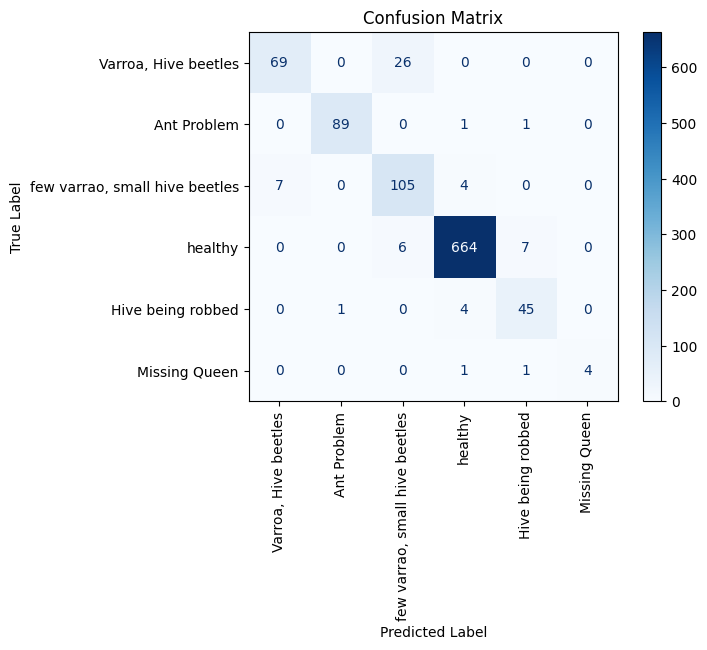

In [ ]:
#tuning_data = pd.read_csv('simple.csv')
#hyper_plotting(tuning_data,'Tuned Simple CNN performance')
model_evaluation(X_test,y_test,'simple_the_best_model.keras')

## Mobilenetv2

In [ ]:
mobile_tuner, mobile_tuner_callbacks = tuner_builder('mobilenet','mobilenet.csv','mobilenet_tuned.keras')

# Search for the best hyperparameters
mobile_tuner.search(X_train, y_train, epochs=20, validation_data=(X_val, y_val), callbacks=mobile_tuner_callbacks)

# Get the best model
best_model = mobile_tuner.get_best_models(num_models=1)[0]

# Save the best model
best_model.save('mobile_the_best_model.keras')

Trial 20 Complete [00h 00m 43s]
val_loss: 0.24698063731193542

Best val_loss So Far: 0.1975935995578766
Total elapsed time: 00h 19m 14s


In [ ]:
best_parameters = mobile_tuner.get_best_hyperparameters()[0]
print(best_parameters.values)

{'dropout_rate': 0.45, 'fully_connected_neurons': 192, 'learn_rate': 0.00019507432807587744}


In [ ]:
%load_ext tensorboard

%tensorboard --logdir /tmp/tb_logs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

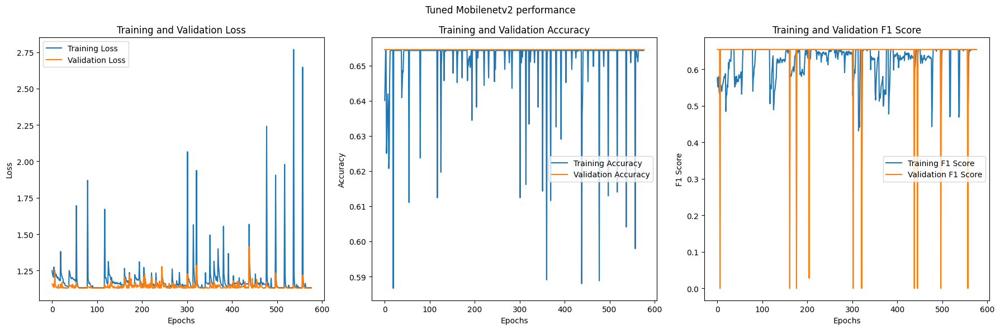

33/33 [==============================] - 3s 21ms/step - loss: 0.2348 - accuracy: 0.9150 - f1_score: 0.9174
Test loss: 0.2348262071609497
Test accuracy: 0.9149758219718933
Test F1 score: 0.9173955321311951
33/33 [==============================] - 1s 12ms/step
Predicted classes: [0 2 1 ... 4 1 4]
True classes: [0 0 1 ... 4 1 4]
Confusion Matrix:


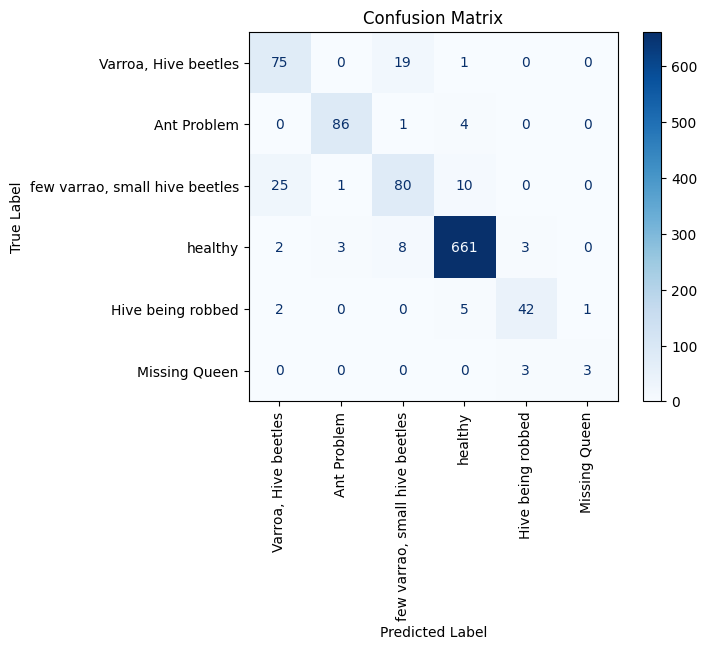

In [ ]:
tuning_data = pd.read_csv('mobilenet.csv')
hyper_plotting(tuning_data,'Tuned Mobilenetv2 performance')
model_evaluation(X_test,y_test,'mobile_the_best_model.keras')

## VGG 16

In [ ]:
vgg16_tuner, vgg16_tuner_callbacks = tuner_builder('vgg16','vgg16.csv','vgg16_tuned.keras')

# Search for the best hyperparameters
vgg16_tuner.search(X_train, y_train, epochs=20, validation_data=(X_val, y_val), callbacks=vgg16_tuner_callbacks)

# Get the best model
best_model = vgg16_tuner.get_best_models(num_models=1)[0]

# Save the best model
best_model.save('vgg16_the_best_model.keras')

Trial 20 Complete [00h 02m 29s]
val_loss: 0.21535630524158478

Best val_loss So Far: 0.20286118984222412
Total elapsed time: 00h 56m 34s


In [ ]:
%load_ext tensorboard

%tensorboard --logdir /tmp/tb_logs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 44881), started 1:05:02 ago. (Use '!kill 44881' to kill it.)

<IPython.core.display.Javascript object>

{'dropout_rate': 0.25, 'fully_connected_neurons': 160, 'learn_rate': 0.000917939120729812}


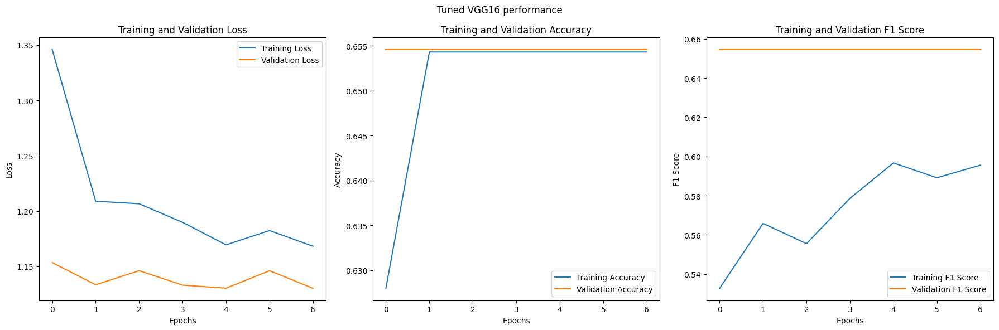

33/33 [==============================] - 2s 33ms/step - loss: 0.2606 - accuracy: 0.9024 - f1_score: 0.9025
Test loss: 0.26057031750679016
Test accuracy: 0.9024154543876648
Test F1 score: 0.9025340676307678
33/33 [==============================] - 1s 30ms/step
Predicted classes: [0 0 1 ... 4 1 4]
True classes: [0 0 1 ... 4 1 4]
Confusion Matrix:


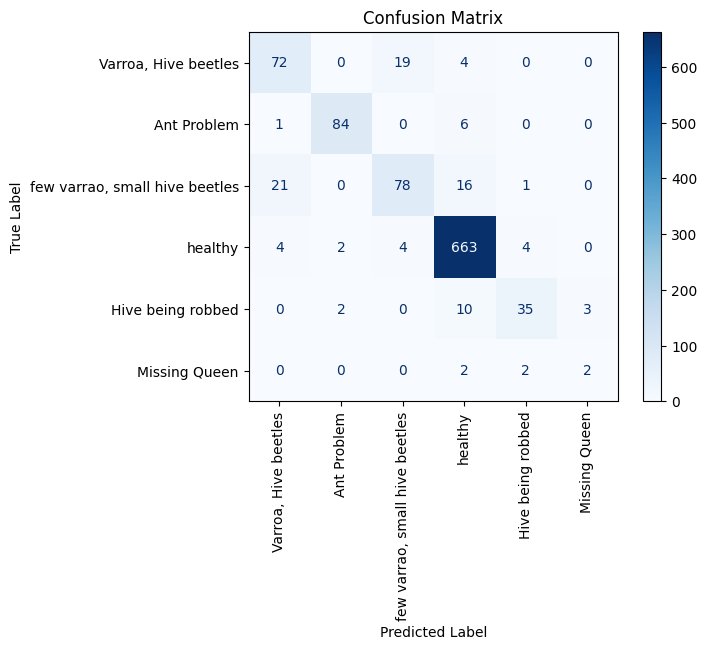

In [ ]:
best_parameters = vgg16_tuner.get_best_hyperparameters()[0]
print(best_parameters.values)

tuning_data = pd.read_csv('vgg16.csv')
hyper_plotting(tuning_data,'Tuned VGG16 performance')
model_evaluation(X_test,y_test,'vgg16_the_best_model.keras')

## ResNet 50

In [ ]:
resnet50_tuner, resnet50_tuner_callbacks = tuner_builder('resnet50','resnet50.csv','resnet50_tuned.keras')

# Search for the best hyperparameters
resnet50_tuner.search(X_train, y_train, epochs=20, validation_data=(X_val, y_val), callbacks=resnet50_tuner_callbacks)

# Get the best model
best_model = resnet50_tuner.get_best_models(num_models=1)[0]

# Save the best model
best_model.save('resnet50_the_best_model.keras')


Search: Running Trial #1

Value             |Best Value So Far |Hyperparameter
0.05              |0.05              |dropout_rate
32                |32                |fully_connected_neurons
0.0037768         |0.0037768         |learn_rate



{'dropout_rate': 0.0, 'fully_connected_neurons': 256, 'learn_rate': 0.0011055415225593402}


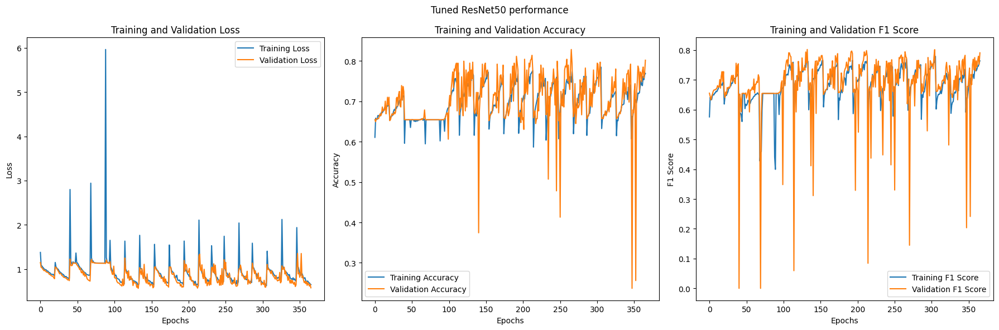

33/33 [==============================] - 3s 35ms/step - loss: 0.6442 - accuracy: 0.7671 - f1_score: 0.7832
Test loss: 0.644196093082428
Test accuracy: 0.7671497464179993
Test F1 score: 0.7831512689590454
33/33 [==============================] - 2s 26ms/step
Predicted classes: [3 3 3 ... 0 3 3]
True classes: [3 3 3 ... 0 3 3]
Confusion Matrix:


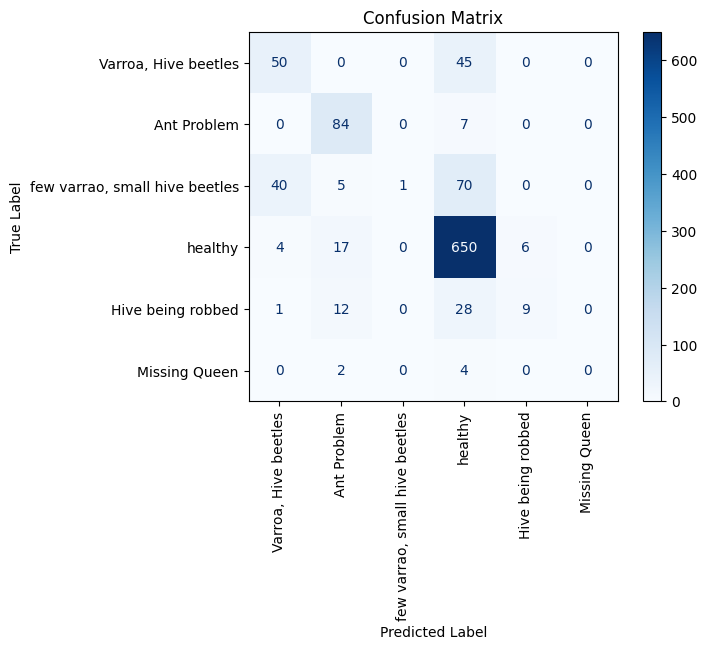

In [ ]:
best_parameters = resnet50_tuner.get_best_hyperparameters()[0]
print(best_parameters.values)

tuning_data = pd.read_csv('resnet50.csv')
hyper_plotting(tuning_data,'Tuned ResNet50 performance')
model_evaluation(X_test,y_test,'resnet50_the_best_model.keras')

## Efficient Net

In [ ]:
efficientnet_tuner, efficientnet_tuner_callbacks = tuner_builder('efficientnet','efficientnet.csv','efficientnet_tuned.keras')

# Search for the best hyperparameters
efficientnet_tuner.search(X_train, y_train, epochs=20, validation_data=(X_val, y_val), callbacks=efficientnet_tuner_callbacks)

# Get the best model
best_model = efficientnet_tuner.get_best_models(num_models=1)[0]

# Save the best model
best_model.save('efficientnet_the_best_model.keras')

Trial 16 Complete [00h 01m 33s]
val_loss: 1.1288409233093262

Best val_loss So Far: 1.1287742853164673
Total elapsed time: 00h 19m 08s

Search: Running Trial #17

Value             |Best Value So Far |Hyperparameter
0.45              |0.4               |dropout_rate
32                |256               |fully_connected_neurons
0.0001            |0.0098795         |learn_rate

Epoch 1/20
114/117 [============================>.] - ETA: 0s - loss: 1.3454 - accuracy: 0.5992 - f1_score: 0.4438
Epoch 1: val_loss improved from inf to 1.17482, saving model to efficientnet_tuned.keras
117/117 [==============================] - 12s 48ms/step - loss: 1.3450 - accuracy: 0.6003 - f1_score: 0.4439 - val_loss: 1.1748 - val_accuracy: 0.6546 - val_f1_score: 0.6546
Epoch 2/20
115/117 [============================>.] - ETA: 0s - loss: 1.3113 - accuracy: 0.6370 - f1_score: 0.4718
Epoch 2: val_loss did not improve from 1.17482
117/117 [==============================] - 3s 22ms/step - loss: 1.3094 - accurac

# BALANCED DATA EXPERIMENTS

With unbalanced data explored and tested, we can begin to unravel the intricacies of the balanced dataset. in this chapter the undersampling will be performed in order to trim down number of samples in each category.

In [ ]:
df_healthy = data[data['health'] == 'healthy']
df_rest = data[data['health'] != 'healthy']

df_health_undersampled = df_healthy.sample(n=600) # rough estimate of the second large class

data_undersampled = pd.concat([df_health_undersampled, df_rest])
data_undersampled = data_undersampled.sample(frac=1).reset_index(drop=True)
data_undersampled.head()

,file,date,time,location,zip code,subspecies,health,pollen_carrying,caste
0,030_474.png,8/17/18,17:50,"Alvin, TX, USA",77511,Italian honey bee,ant problems,False,worker
1,038_339.png,8/18/18,12:30,"Athens, Georgia, USA",30607,1 Mixed local stock 2,"Varroa, Small Hive Beetles",False,worker
2,021_194.png,8/8/18,21:13,"Saratoga, CA, USA",95070,Italian honey bee,healthy,False,worker
3,040_275.png,8/21/18,15:56,"Athens, GA, USA",30607,Italian honey bee,"few varrao, hive beetles",False,worker
4,005_206.png,7/7/18,12:56,"Saratoga, CA, USA",95070,Italian honey bee,healthy,False,worker


In [ ]:
train_bees , test_bees = train_test_split(data_undersampled, test_size= 0.2, stratify=data_undersampled['health'])
train_bees , val_bees = train_test_split(train_bees, test_size= 0.1, stratify= train_bees['health'])

X_train = np.stack(train_bees['file'].apply(prepare_img))
y_train = pd.get_dummies(train_bees['health'], drop_first=False)

X_val = np.stack(val_bees['file'].apply(prepare_img))
y_val = pd.get_dummies(val_bees['health'], drop_first=False)

X_test = np.stack(test_bees['file'].apply(prepare_img))
y_test = pd.get_dummies(test_bees['health'], drop_first=False)

In [ ]:
print(X_train.shape)
print(X_val.shape)
print(X_test.shape)

(1719, 100, 100, 3)
(191, 100, 100, 3)
(478, 100, 100, 3)


# Model Selection

/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - accuracy: 0.3314 - f1_score: 0.1211 - loss: 1.5729
Epoch 1: val_loss improved from inf to 0.89316, saving model to simple_model.keras
54/54 ━━━━━━━━━━━━━━━━━━━━ 15s 107ms/step - accuracy: 0.3330 - f1_score: 0.1235 - loss: 1.5689 - val_accuracy: 0.6754 - val_f1_score: 0.4427 - val_loss: 0.8932
Epoch 2/50
51/54 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - accuracy: 0.6107 - f1_score: 0.5401 - loss: 0.9367
Epoch 2: val_loss improved from 0.89316 to 0.63997, saving model to simple_model.keras
54/54 ━━━━━━━━━━━━━━━━━━━━ 9s 16ms/step - accuracy: 0.6124 - f1_score: 0.5431 - loss: 0.9329 - val_accuracy: 0.7644 - val_f1_score: 0.7225 - val_loss: 0.6400
Epoch 3/50
52/54 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.6713 - f1_score: 0.6362 - loss: 0.7320
Epoch 3: val_loss did not improve from 0.63997
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.6710 - f1_score: 0.6356 - loss: 0.7328 - val_accuracy: 0.7225 - val_f1_score: 0.7314 - val_loss: 0.

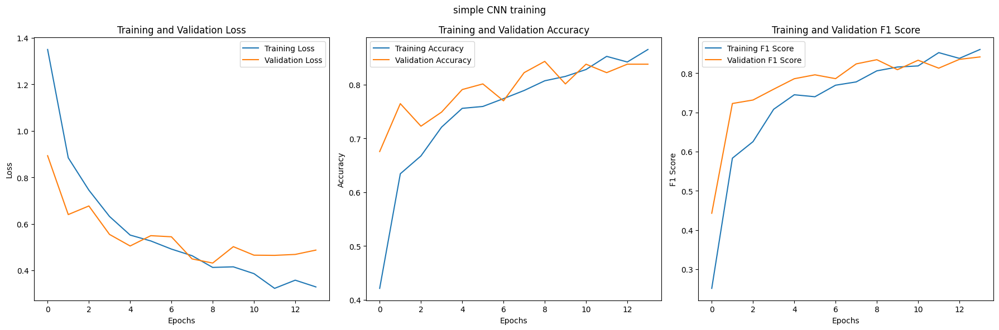

15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 57ms/step - accuracy: 0.8561 - f1_score: 0.8545 - loss: 0.3194
Test loss: 0.31042033433914185
Test accuracy: 0.8619247078895569
Test F1 score: 0.8622502088546753
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
Predicted classes: [3 1 3 3 3 2 3 3 1 3 2 0 4 3 0 0 2 0 1 3 4 3 2 3 3 1 3 1 5 4 4 1 1 1 3 2 0
 2 3 3 2 3 2 1 2 3 0 2 2 4 3 2 0 2 3 3 1 3 1 3 3 3 0 2 2 1 1 4 1 2 4 0 2 1
 2 4 0 2 3 2 3 3 0 3 2 1 2 2 2 1 2 0 3 1 3 3 0 0 2 3 3 4 2 4 2 3 1 1 1 1 2
 4 0 2 1 3 1 3 4 3 1 0 3 5 0 2 2 4 1 1 0 2 1 1 3 2 4 1 0 0 2 4 1 1 0 2 4 3
 2 1 4 2 2 3 4 0 2 4 2 2 1 1 3 3 3 0 4 0 2 3 3 3 3 2 2 0 3 2 1 1 3 2 2 2 2
 4 2 0 3 3 1 2 3 3 1 1 3 2 2 2 1 3 2 1 2 3 0 1 3 2 2 0 2 2 1 4 1 2 3 2 3 0
 2 3 3 2 1 4 2 3 0 1 2 3 2 0 1 2 1 1 1 2 2 1 3 2 0 4 2 4 2 3 5 3 2 2 3 1 3
 3 0 1 2 2 3 2 0 1 3 2 3 2 1 4 2 1 2 1 0 3 2 2 2 2 4 0 3 1 5 2 3 0 3 0 1 1
 2 3 2 4 2 1 2 2 0 4 3 1 1 2 1 3 3 2 1 0 2 3 3 2 3 0 2 3 2 4 3 0 3 2 4 4 4
 1 2 3 2 3 1 3 2 3 1 2 1 4 2 1 0 3 2 4 3 3 2 2 1 3 2 2 3 4 3 0 3 3 4 1 2 2

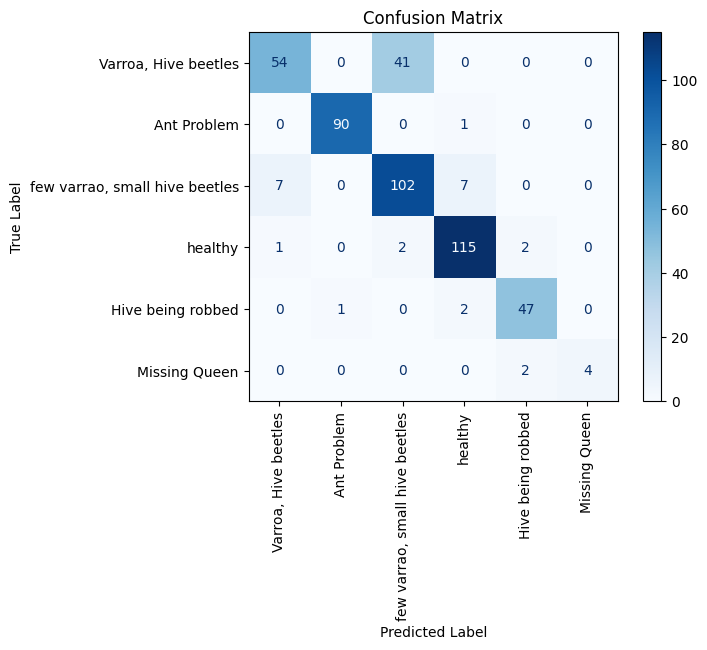

In [ ]:
# @title Simple CNN
mymodel, mymodel_callbacks = build_model(dropout_rate= 0.5, model_name='simple_model.keras')

myhistory = mymodel.fit(
            X_train,y_train,
            epochs=50,
            batch_size=32,
            validation_data=(X_val,y_val),
            callbacks=mymodel_callbacks,
            verbose=1)

plot_training_history(myhistory, "simple CNN training")
model_evaluation(X_test, y_test, mymodel)

<ipython-input-17-c64cf2861d8e>:4: UserWarning: `input_shape` is undefined or non-square, or `rows` is not in [96, 128, 160, 192, 224]. Weights for input shape (224, 224) will be loaded as the default.
  mobilenet_base = tf.keras.applications.MobileNetV2(weights='imagenet', include_top=False, input_shape=input_shape)


Epoch 1/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step - accuracy: 0.3371 - f1_score: 0.2822 - loss: 2.6460
Epoch 1: val_loss improved from inf to 0.97027, saving model to Mobile_model.keras
54/54 ━━━━━━━━━━━━━━━━━━━━ 19s 201ms/step - accuracy: 0.3386 - f1_score: 0.2833 - loss: 2.6297 - val_accuracy: 0.6387 - val_f1_score: 0.5871 - val_loss: 0.9703
Epoch 2/50
52/54 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.5617 - f1_score: 0.5263 - loss: 1.0684
Epoch 2: val_loss improved from 0.97027 to 0.81966, saving model to Mobile_model.keras
54/54 ━━━━━━━━━━━━━━━━━━━━ 8s 22ms/step - accuracy: 0.5624 - f1_score: 0.5280 - loss: 1.0666 - val_accuracy: 0.7016 - val_f1_score: 0.6460 - val_loss: 0.8197
Epoch 3/50
51/54 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - accuracy: 0.5843 - f1_score: 0.5537 - loss: 0.9781
Epoch 3: val_loss improved from 0.81966 to 0.78161, saving model to Mobile_model.keras
54/54 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - accuracy: 0.5856 - f1_score: 0.5561 - loss: 0.9737 - val_accuracy: 0.72

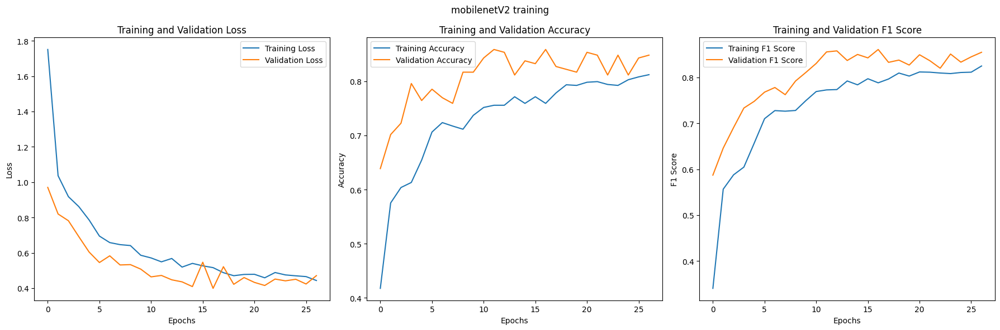

15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 98ms/step - accuracy: 0.8271 - f1_score: 0.8182 - loss: 0.7454
Test loss: 0.6176072955131531
Test accuracy: 0.8347280621528625
Test F1 score: 0.83244389295578
15/15 ━━━━━━━━━━━━━━━━━━━━ 6s 312ms/step
Predicted classes: [3 1 2 1 3 2 3 3 1 3 2 2 4 3 0 0 2 0 4 3 4 3 2 3 3 1 3 1 4 2 3 1 1 1 3 2 2
 2 3 3 2 3 0 2 0 3 0 1 2 4 3 2 0 2 0 3 4 3 1 0 4 3 0 0 2 2 1 4 1 2 4 0 0 1
 0 4 0 2 3 2 3 2 0 0 2 1 0 2 2 1 2 2 2 1 3 3 0 0 2 3 3 4 2 4 0 3 1 1 1 1 2
 4 0 2 1 3 1 2 4 3 1 0 3 4 2 2 2 4 1 1 0 2 1 1 3 2 4 1 2 0 2 4 1 1 0 2 4 3
 2 1 4 0 2 3 4 0 3 4 1 2 1 1 3 4 3 0 4 0 2 3 3 3 3 0 0 0 3 2 1 1 3 2 2 0 2
 4 0 0 3 3 1 2 4 3 1 1 3 2 0 2 1 3 2 1 2 3 0 1 3 2 2 0 2 2 1 4 1 2 3 0 3 0
 2 2 3 2 1 4 2 3 0 1 2 3 0 0 1 2 1 1 1 2 2 1 3 0 0 4 3 4 2 0 4 3 2 0 3 1 3
 3 0 1 3 0 3 0 2 1 3 0 3 0 1 4 2 1 2 1 2 2 0 0 0 2 4 0 3 1 3 2 3 0 3 3 1 1
 2 3 2 4 2 1 2 2 2 4 3 1 1 2 1 2 3 2 1 0 2 3 3 2 0 0 2 3 2 3 3 0 0 2 4 4 4
 1 2 3 2 3 1 3 2 2 1 2 1 4 2 1 0 3 0 4 3 3 2 2 1 3 2 2 2 1 3 0 3 1 4 1 2 2
 

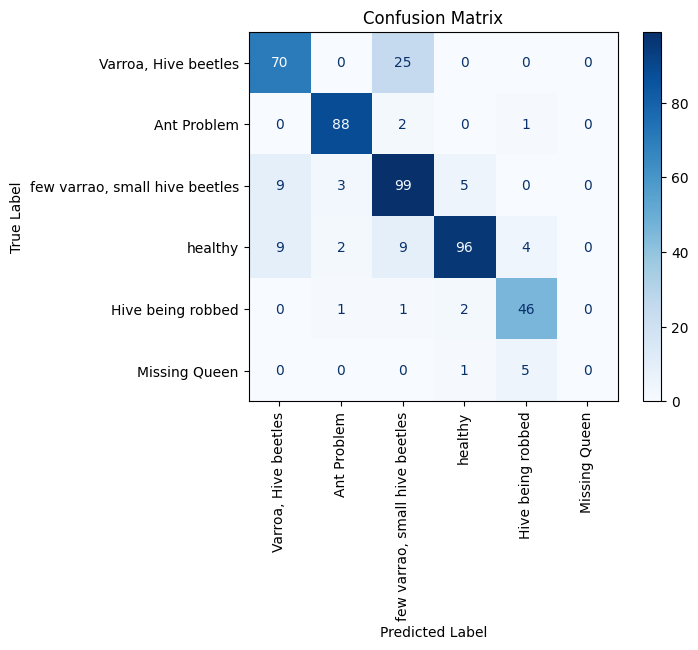

In [ ]:
# @title Mobilenetv2

input_shape = (img_width,img_height,img_channels)
mobilenet_base = tf.keras.applications.MobileNetV2(weights='imagenet', include_top=False, input_shape=input_shape)
mobilenet_base.trainable = False

mobile_model, mobile_callbacks = build_model(base=mobilenet_base,dropout_rate=0.5, model_name='Mobile_model.keras')

mobile_history = mobile_model.fit(X_train, y_train,
                                  validation_data=(X_val, y_val),
                                  epochs=50,
                                  batch_size=32,
                                  callbacks=mobile_callbacks,
                                  verbose=1)

plot_training_history(mobile_history,"mobilenetV2 training")
model_evaluation(X_test, y_test, mobile_model)

58889256/58889256 ━━━━━━━━━━━━━━━━━━━━ 2s 0us/step
Epoch 1/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step - accuracy: 0.3709 - f1_score: 0.2372 - loss: 1.5553
Epoch 1: val_loss improved from inf to 0.85503, saving model to vgg16_model.keras
54/54 ━━━━━━━━━━━━━━━━━━━━ 19s 234ms/step - accuracy: 0.3730 - f1_score: 0.2392 - loss: 1.5507 - val_accuracy: 0.6911 - val_f1_score: 0.5632 - val_loss: 0.8550
Epoch 2/50
53/54 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - accuracy: 0.6478 - f1_score: 0.5528 - loss: 0.9110
Epoch 2: val_loss improved from 0.85503 to 0.68097, saving model to vgg16_model.keras
54/54 ━━━━━━━━━━━━━━━━━━━━ 6s 49ms/step - accuracy: 0.6483 - f1_score: 0.5543 - loss: 0.9097 - val_accuracy: 0.7696 - val_f1_score: 0.7200 - val_loss: 0.6810
Epoch 3/50
53/54 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - accuracy: 0.7139 - f1_score: 0.6473 - loss: 0.7552
Epoch 3: val_loss improved from 0.68097 to 0.58591, saving model to vgg16_model.keras
54/54 ━━━━━━━━━━━━━━━━━━━━ 2s 46ms/step - accuracy: 0.7143 - f1_

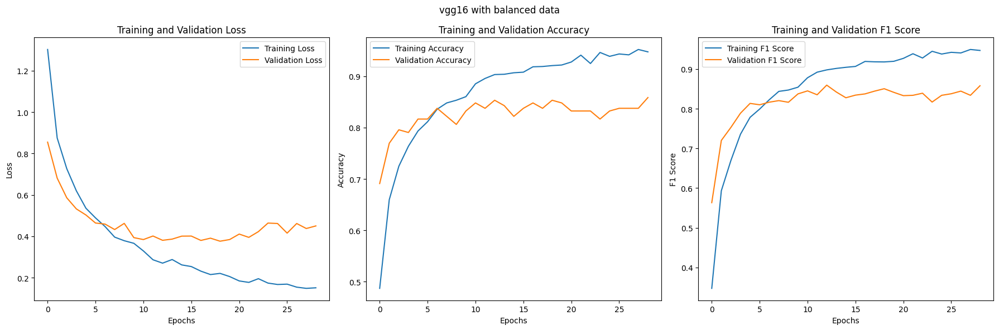

15/15 ━━━━━━━━━━━━━━━━━━━━ 4s 292ms/step - accuracy: 0.8498 - f1_score: 0.8518 - loss: 0.4196
Test loss: 0.3452564477920532
Test accuracy: 0.8786610960960388
Test F1 score: 0.8793283700942993
15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 59ms/step
Predicted classes: [3 1 0 1 3 3 3 3 1 4 2 2 4 3 2 0 2 0 4 3 4 3 0 3 3 1 3 1 5 3 3 1 1 1 3 0 0
 0 3 3 2 3 0 1 0 3 0 2 2 4 3 2 0 2 3 3 4 3 1 3 4 3 0 0 2 3 1 4 1 0 4 0 0 1
 0 2 2 0 3 2 3 3 0 2 2 3 0 2 0 1 0 0 0 1 4 0 0 0 2 3 3 4 0 4 3 3 1 1 1 1 2
 4 0 2 1 3 1 0 4 3 1 0 3 4 2 2 2 4 1 1 0 2 1 1 3 3 4 1 0 0 2 4 1 1 0 2 4 3
 2 1 4 0 2 3 4 0 2 4 3 2 1 1 3 4 3 0 4 0 4 3 3 3 3 0 0 0 3 2 1 1 3 2 0 2 0
 4 0 0 3 3 1 2 3 3 1 1 3 2 0 2 1 3 2 1 2 3 0 1 3 2 2 0 0 2 1 4 1 2 3 0 3 0
 0 2 3 2 1 3 2 3 0 1 2 3 0 0 1 2 3 1 1 0 2 1 3 0 0 4 2 4 2 2 5 3 2 0 3 1 3
 3 0 1 3 2 3 2 2 1 3 0 3 0 1 4 0 1 2 1 0 3 0 3 0 2 4 0 3 1 5 2 3 0 3 0 1 1
 2 3 2 4 0 1 2 2 0 4 3 1 1 2 1 2 3 2 1 2 2 3 3 2 3 0 2 3 2 4 3 0 3 2 4 4 4
 1 0 3 2 3 1 3 2 3 1 2 1 4 2 1 0 3 0 4 3 3 2 0 1 3 2 2 3 4 3 0 3 1 4 1 2 2

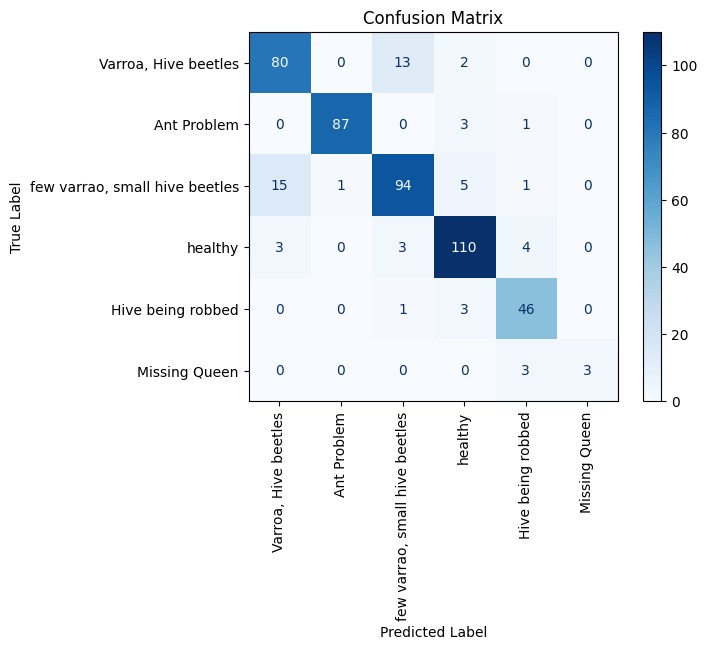

In [ ]:
# @title VGG 16

input_shape = (img_height, img_width, img_channels)
vgg16_base = tf.keras.applications.VGG16(weights='imagenet', include_top=False, input_shape=input_shape)
vgg16_base.trainable = False

vgg16_model, vgg16_callbacks = build_model(base=vgg16_base, dropout_rate=0.5, model_name='vgg16_model.keras')

vgg16_history = vgg16_model.fit(X_train,y_train,
                                validation_data=(X_val,y_val),
                                epochs=50,
                                batch_size=32,
                                callbacks=vgg16_callbacks,
                                verbose=1)

plot_training_history(vgg16_history,"vgg16 with balanced data")
model_evaluation(X_test, y_test, vgg16_model)

94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 3s 0us/step
Epoch 1/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step - accuracy: 0.2078 - f1_score: 0.0741 - loss: 2.7844
Epoch 1: val_loss improved from inf to 1.77912, saving model to resnet_model.keras
54/54 ━━━━━━━━━━━━━━━━━━━━ 26s 259ms/step - accuracy: 0.2081 - f1_score: 0.0734 - loss: 2.7716 - val_accuracy: 0.2408 - val_f1_score: 0.0000e+00 - val_loss: 1.7791
Epoch 2/50
53/54 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - accuracy: 0.2427 - f1_score: 0.0000e+00 - loss: 1.7759
Epoch 2: val_loss improved from 1.77912 to 1.76369, saving model to resnet_model.keras
54/54 ━━━━━━━━━━━━━━━━━━━━ 4s 48ms/step - accuracy: 0.2427 - f1_score: 0.0000e+00 - loss: 1.7757 - val_accuracy: 0.2408 - val_f1_score: 0.0000e+00 - val_loss: 1.7637
Epoch 3/50
53/54 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - accuracy: 0.2318 - f1_score: 0.0000e+00 - loss: 1.7614
Epoch 3: val_loss improved from 1.76369 to 1.74954, saving model to resnet_model.keras
54/54 ━━━━━━━━━━━━━━━━━━━━ 3s 49ms/step -

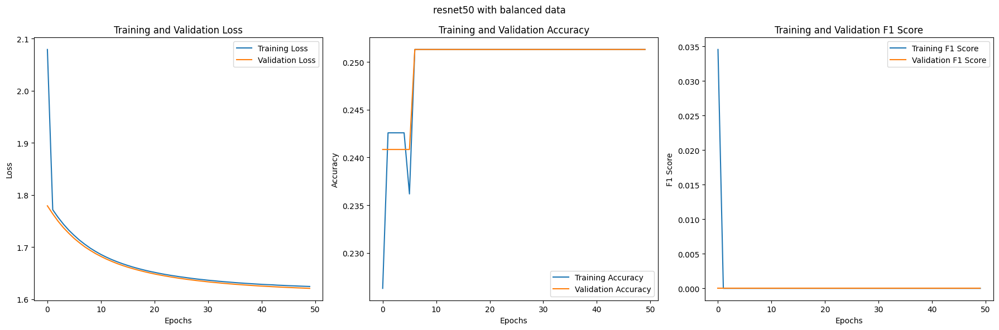

15/15 ━━━━━━━━━━━━━━━━━━━━ 4s 265ms/step - accuracy: 0.2702 - f1_score: 0.0000e+00 - loss: 1.6310
Test loss: 1.624211311340332
Test accuracy: 0.2510460317134857
Test F1 score: 0.0
15/15 ━━━━━━━━━━━━━━━━━━━━ 6s 238ms/step
Predicted classes: [3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
 3 3 3 3 3

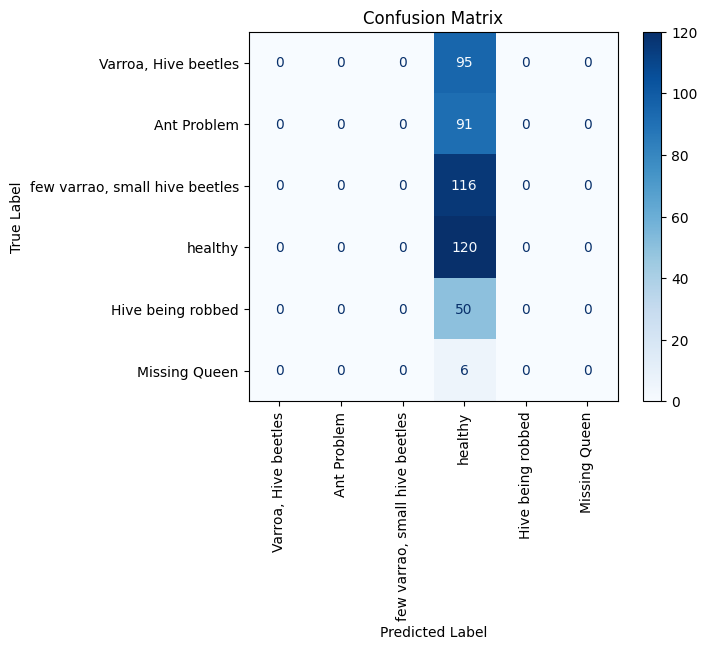

In [ ]:
# @title ResNet50

resnet_base = tf.keras.applications.ResNet50(weights='imagenet', include_top=False, input_shape=input_shape)
resnet_base.trainable = False

resnet_model, resnet_callbacks = build_model(base = resnet_base, dropout_rate=0.5, model_name='resnet_model.keras')

resnet_history = resnet_model.fit(X_train,y_train,
                                validation_data=(X_val,y_val),
                                epochs=50,
                                batch_size=32,
                                callbacks=resnet_callbacks,
                                verbose=1)

plot_training_history(resnet_history,"resnet50 with balanced data")
model_evaluation(X_test, y_test, resnet_model)

16705208/16705208 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step
Epoch 1/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step - accuracy: 0.2171 - f1_score: 0.0477 - loss: 1.9825
Epoch 1: val_loss improved from inf to 1.67962, saving model to efficient_model.keras
54/54 ━━━━━━━━━━━━━━━━━━━━ 47s 472ms/step - accuracy: 0.2174 - f1_score: 0.0471 - loss: 1.9793 - val_accuracy: 0.2513 - val_f1_score: 0.0000e+00 - val_loss: 1.6796
Epoch 2/50
52/54 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - accuracy: 0.2079 - f1_score: 0.0000e+00 - loss: 1.7368
Epoch 2: val_loss improved from 1.67962 to 1.65430, saving model to efficient_model.keras
54/54 ━━━━━━━━━━━━━━━━━━━━ 6s 26ms/step - accuracy: 0.2091 - f1_score: 0.0000e+00 - loss: 1.7362 - val_accuracy: 0.2513 - val_f1_score: 0.0000e+00 - val_loss: 1.6543
Epoch 3/50
50/54 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.2266 - f1_score: 0.0000e+00 - loss: 1.7091
Epoch 3: val_loss improved from 1.65430 to 1.63521, saving model to efficient_model.keras
54/54 ━━━━━━━━━━━━━━━━━━━━ 2s 24

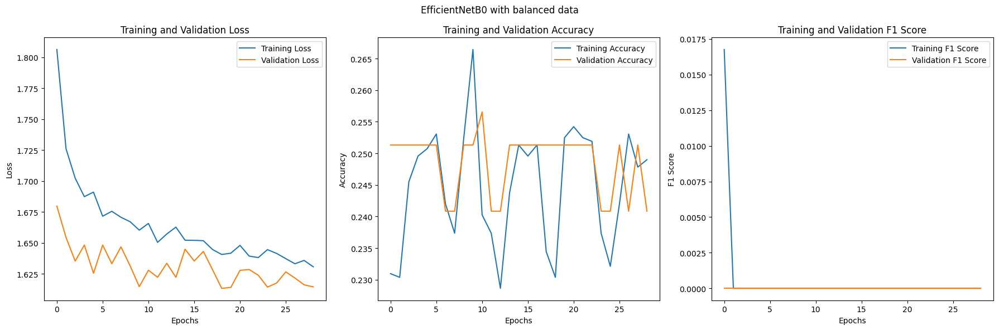

15/15 ━━━━━━━━━━━━━━━━━━━━ 5s 321ms/step - accuracy: 0.2124 - f1_score: 0.0000e+00 - loss: 1.6296
Test loss: 1.6190898418426514
Test accuracy: 0.24267782270908356
Test F1 score: 0.0
15/15 ━━━━━━━━━━━━━━━━━━━━ 12s 431ms/step
Predicted classes: [2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 

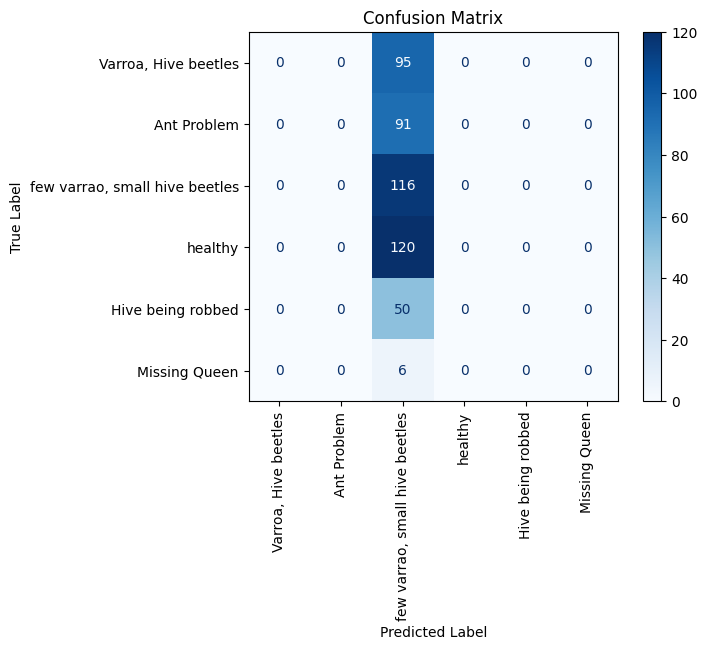

In [ ]:
# @title Efficient Net

efficient_base = tf.keras.applications.EfficientNetB0(weights='imagenet', include_top=False, input_shape=input_shape)
efficient_base.trainable = False

efficient_model, efficient_callbacks = build_model(base = efficient_base, dropout_rate=0.5, model_name='efficient_model.keras')

efficient_history = efficient_model.fit(X_train,y_train,
                                validation_data=(X_val,y_val),
                                epochs=50,
                                batch_size=32,
                                callbacks=efficient_callbacks,
                                verbose=1)

plot_training_history(efficient_history,"EfficientNetB0 with balanced data")
model_evaluation(X_test, y_test, efficient_model)


# Trainable models (unbalanced data)

Reverting back to the unbalanced data for the sake of testing what improvement it gets over baseline during this batch of tests one will be trying to see whether making all layers in model trainable impact the outcome of after the learning. With this test being second to last.

In [ ]:
input_shape = (img_width,img_height,img_channels)
temp = tf.keras.applications.EfficientNetB0(weights='imagenet', include_top=False, input_shape=input_shape)
temp.trainable = True
temp.summary()

16705208/16705208 ━━━━━━━━━━━━━━━━━━━━ 2s 0us/step


Model: "efficientnetb0"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_8             │ (None, 100, 100, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ rescaling (Rescaling)     │ (None, 100, 100, 3)    │              0 │ input_layer_8[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ normalization             │ (None, 100, 100, 3)    │              7 │ rescaling[0][0]        │
│ (Normalization)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ rescaling_1 (Rescaling)   │ (None, 100, 100, 3)    │              0 │ normalization[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ stem_conv_pad             │ (None, 101, 101, 3)    │              0 │ rescaling_1[0][0]      │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ stem_conv (Conv2D)        │ (None, 50, 50, 32)     │            864 │ stem_conv_pad[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ stem_bn                   │ (None, 50, 50, 32)     │            128 │ stem_conv[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ stem_activation           │ (None, 50, 50, 32)     │              0 │ stem_bn[0][0]          │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1a_dwconv            │ (None, 50, 50, 32)     │            288 │ stem_activation[0][0]  │
│ (DepthwiseConv2D)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1a_bn                │ (None, 50, 50, 32)     │            128 │ block1a_dwconv[0][0]   │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1a_activation        │ (None, 50, 50, 32)     │              0 │ block1a_bn[0][0]       │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1a_se_squeeze        │ (None, 32)             │              0 │ block1a_activation[0]… │
│ (GlobalAveragePooling2D)  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1a_se_reshape        │ (None, 1, 1, 32)       │              0 │ block1a_se_squeeze[0]… │
│ (Reshape)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1a_se_reduce         │ (None, 1, 1, 8)        │            264 │ block1a_se_reshape[0]… │
│ (Conv2D)                  │                        │                │                        │
├──────────────────────

 Total params: 4,049,571 (15.45 MB)

 Trainable params: 4,007,548 (15.29 MB)

 Non-trainable params: 42,023 (164.16 KB)

<ipython-input-10-37e0f46fb694>:3: UserWarning: `input_shape` is undefined or non-square, or `rows` is not in [96, 128, 160, 192, 224]. Weights for input shape (224, 224) will be loaded as the default.
  mobilenet_base = tf.keras.applications.MobileNetV2(weights='imagenet', include_top=False, input_shape=input_shape)


9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
Epoch 1/50
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step - accuracy: 0.6912 - f1_score: 0.6945 - loss: 1.1489
Epoch 1: val_loss improved from inf to 12.89143, saving model to Mobile_model.keras
117/117 ━━━━━━━━━━━━━━━━━━━━ 91s 301ms/step - accuracy: 0.6920 - f1_score: 0.6953 - loss: 1.1449 - val_accuracy: 0.6546 - val_f1_score: 0.6546 - val_loss: 12.8914
Epoch 2/50
116/117 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - accuracy: 0.8819 - f1_score: 0.8847 - loss: 0.3450
Epoch 2: val_loss improved from 12.89143 to 4.03532, saving model to Mobile_model.keras
117/117 ━━━━━━━━━━━━━━━━━━━━ 27s 49ms/step - accuracy: 0.8819 - f1_score: 0.8847 - loss: 0.3450 - val_accuracy: 0.6498 - val_f1_score: 0.6505 - val_loss: 4.0353
Epoch 3/50
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - accuracy: 0.9082 - f1_score: 0.9020 - loss: 0.2877
Epoch 3: val_loss did not improve from 4.03532
117/117 ━━━━━━━━━━━━━━━━━━━━ 9s 36ms/step - accuracy: 0.9082 - f1_score: 0.9020 - loss: 0

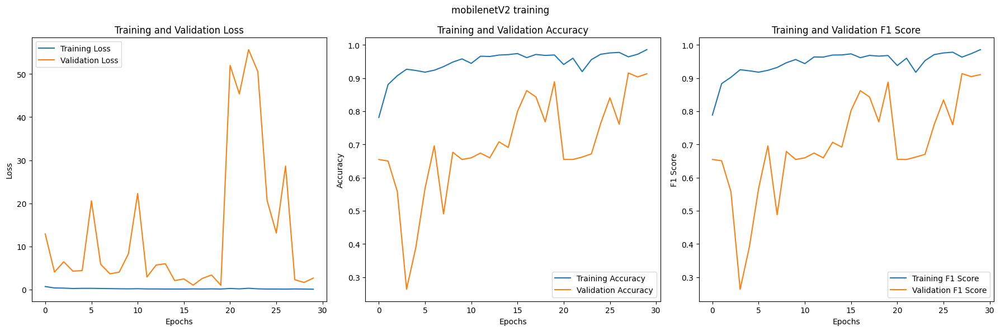

33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step - accuracy: 0.9041 - f1_score: 0.9041 - loss: 2.4243
Test loss: 2.486050605773926
Test accuracy: 0.8995168805122375
Test F1 score: 0.8995168209075928
33/33 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step
Predicted classes: [0 3 0 ... 0 3 3]
True classes: [0 3 3 ... 0 3 3]
Confusion Matrix:


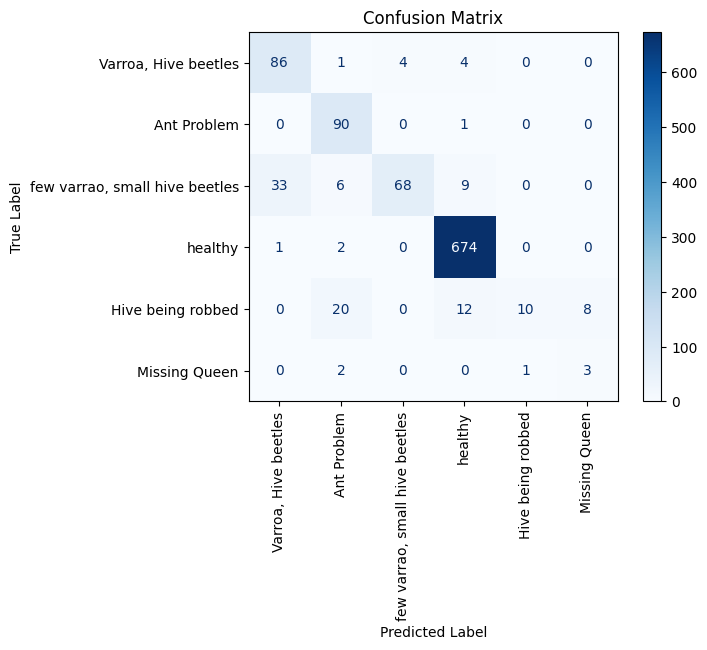

In [ ]:
# @title Mobilenet v2
input_shape = (img_width,img_height,img_channels)
mobilenet_base = tf.keras.applications.MobileNetV2(weights='imagenet', include_top=False, input_shape=input_shape)
mobilenet_base.trainable = True

mobile_model, mobile_callbacks = build_model(base=mobilenet_base,dropout_rate=0.5, model_name='Mobile_model.keras')

mobile_history = mobile_model.fit(X_train, y_train,
                                  validation_data=(X_val, y_val),
                                  epochs=50,
                                  batch_size=32,
                                  callbacks=mobile_callbacks,
                                  verbose=1)

plot_training_history(mobile_history,"mobilenetV2 training")
model_evaluation(X_test, y_test, mobile_model)


58889256/58889256 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
Epoch 1/50
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step - accuracy: 0.5744 - f1_score: 0.4740 - loss: 1.4311
Epoch 1: val_loss improved from inf to 0.72931, saving model to vgg16_model.keras
117/117 ━━━━━━━━━━━━━━━━━━━━ 48s 280ms/step - accuracy: 0.5749 - f1_score: 0.4748 - loss: 1.4290 - val_accuracy: 0.7077 - val_f1_score: 0.7214 - val_loss: 0.7293
Epoch 2/50
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step - accuracy: 0.6920 - f1_score: 0.6880 - loss: 0.8285
Epoch 2: val_loss improved from 0.72931 to 0.66168, saving model to vgg16_model.keras
117/117 ━━━━━━━━━━━━━━━━━━━━ 17s 142ms/step - accuracy: 0.6920 - f1_score: 0.6879 - loss: 0.8287 - val_accuracy: 0.7126 - val_f1_score: 0.7555 - val_loss: 0.6617
Epoch 3/50
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step - accuracy: 0.7058 - f1_score: 0.7185 - loss: 0.7475
Epoch 3: val_loss improved from 0.66168 to 0.54121, saving model to vgg16_model.keras
117/117 ━━━━━━━━━━━━━━━━━━━━ 20s 135ms/step - accu

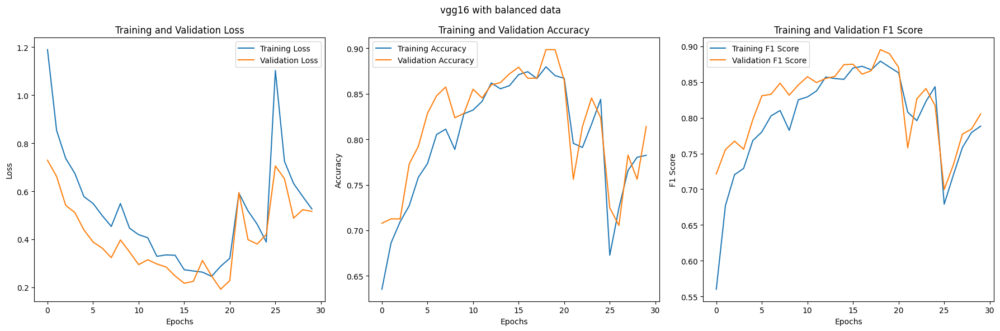

33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 104ms/step - accuracy: 0.8032 - f1_score: 0.7894 - loss: 0.5512
Test loss: 0.5264253616333008
Test accuracy: 0.809661865234375
Test F1 score: 0.7933260798454285
33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 52ms/step
Predicted classes: [2 3 3 ... 2 3 3]
True classes: [0 3 3 ... 0 3 3]
Confusion Matrix:


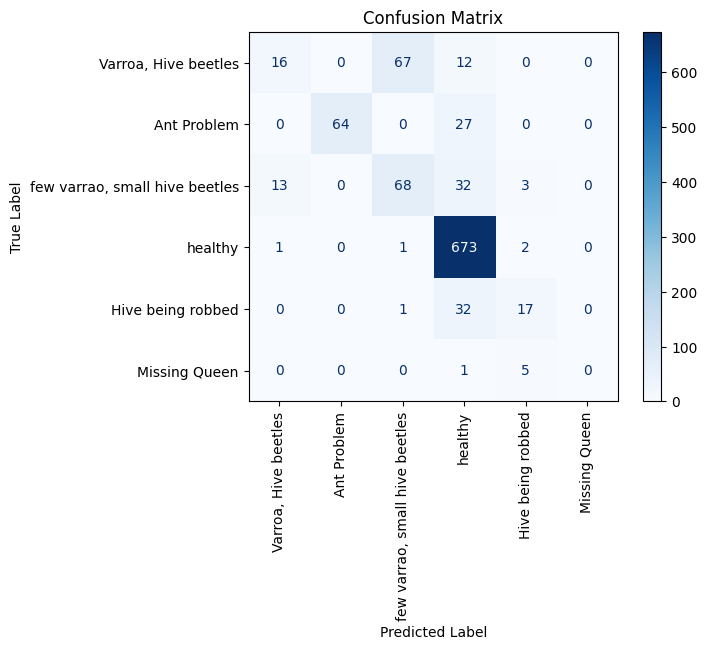

In [ ]:
# @title VGG 16

input_shape = (img_height, img_width, img_channels)
vgg16_base = tf.keras.applications.VGG16(weights='imagenet', include_top=False, input_shape=input_shape)
vgg16_base.trainable = True

vgg16_model, vgg16_callbacks = build_model(base=vgg16_base, dropout_rate=0.5, model_name='vgg16_model.keras')

vgg16_history = vgg16_model.fit(X_train,y_train,
                                validation_data=(X_val,y_val),
                                epochs=50,
                                batch_size=32,
                                callbacks=vgg16_callbacks,
                                verbose=1)

plot_training_history(vgg16_history,"vgg16 with balanced data")
model_evaluation(X_test, y_test, vgg16_model)

94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
Epoch 1/50
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step - accuracy: 0.6971 - f1_score: 0.6881 - loss: 1.2334
Epoch 1: val_loss improved from inf to 2.47209, saving model to resnet_model.keras
117/117 ━━━━━━━━━━━━━━━━━━━━ 124s 505ms/step - accuracy: 0.6978 - f1_score: 0.6888 - loss: 1.2292 - val_accuracy: 0.1111 - val_f1_score: 0.0000e+00 - val_loss: 2.4721
Epoch 2/50
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step - accuracy: 0.8791 - f1_score: 0.8768 - loss: 0.3354
Epoch 2: val_loss improved from 2.47209 to 1.58071, saving model to resnet_model.keras
117/117 ━━━━━━━━━━━━━━━━━━━━ 20s 168ms/step - accuracy: 0.8791 - f1_score: 0.8768 - loss: 0.3355 - val_accuracy: 0.2150 - val_f1_score: 0.0000e+00 - val_loss: 1.5807
Epoch 3/50
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step - accuracy: 0.8951 - f1_score: 0.8949 - loss: 0.3147
Epoch 3: val_loss improved from 1.58071 to 1.39844, saving model to resnet_model.keras
117/117 ━━━━━━━━━━━━━━━━━━━━ 22s 178ms/

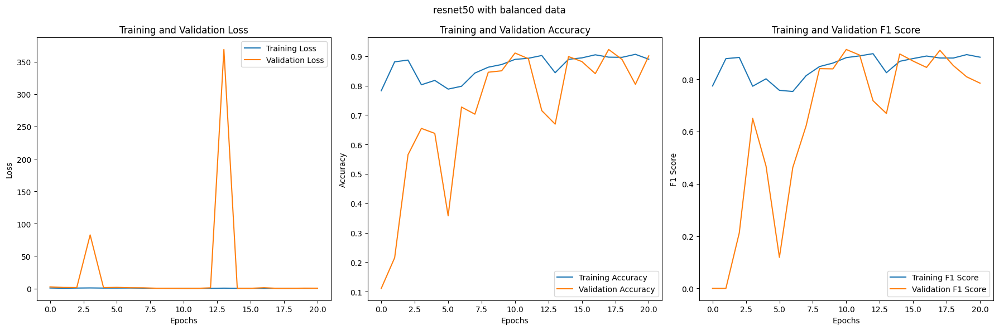

33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 80ms/step - accuracy: 0.8958 - f1_score: 0.8281 - loss: 0.3827
Test loss: 0.41005051136016846
Test accuracy: 0.9004830718040466
Test F1 score: 0.8191267848014832
33/33 ━━━━━━━━━━━━━━━━━━━━ 8s 124ms/step
Predicted classes: [2 3 3 ... 2 3 3]
True classes: [0 3 3 ... 0 3 3]
Confusion Matrix:


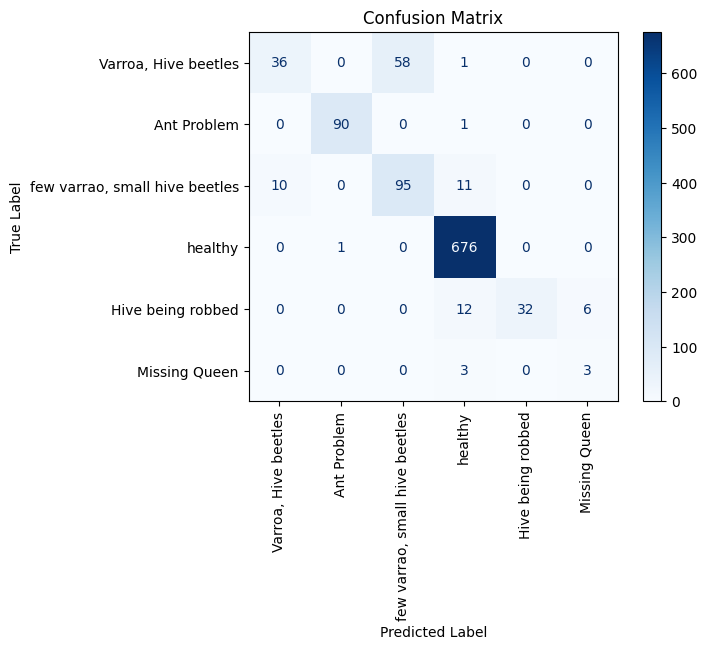

In [ ]:
# @title ResNet50

resnet_base = tf.keras.applications.ResNet50(weights='imagenet', include_top=False, input_shape=input_shape)
resnet_base.trainable = True

resnet_model, resnet_callbacks = build_model(base = resnet_base, dropout_rate=0.5, model_name='resnet_model.keras')

resnet_history = resnet_model.fit(X_train,y_train,
                                validation_data=(X_val,y_val),
                                epochs=50,
                                batch_size=32,
                                callbacks=resnet_callbacks,
                                verbose=1)

plot_training_history(resnet_history,"resnet50 with balanced data")
model_evaluation(X_test, y_test, resnet_model)

16705208/16705208 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
Epoch 1/50
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step - accuracy: 0.5701 - f1_score: 0.4665 - loss: 1.4286
Epoch 1: val_loss improved from inf to 1.18695, saving model to efficient_model.keras
117/117 ━━━━━━━━━━━━━━━━━━━━ 48s 222ms/step - accuracy: 0.5703 - f1_score: 0.4665 - loss: 1.4279 - val_accuracy: 0.6546 - val_f1_score: 0.0000e+00 - val_loss: 1.1870
Epoch 2/50
113/117 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - accuracy: 0.6518 - f1_score: 0.4497 - loss: 1.3277
Epoch 2: val_loss improved from 1.18695 to 1.13654, saving model to efficient_model.keras
117/117 ━━━━━━━━━━━━━━━━━━━━ 6s 22ms/step - accuracy: 0.6519 - f1_score: 0.4501 - loss: 1.3274 - val_accuracy: 0.6546 - val_f1_score: 0.6546 - val_loss: 1.1365
Epoch 3/50
114/117 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - accuracy: 0.6580 - f1_score: 0.4995 - loss: 1.2504
Epoch 3: val_loss did not improve from 1.13654
117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - accuracy: 0.6578 - f1_score: 0.4990 -

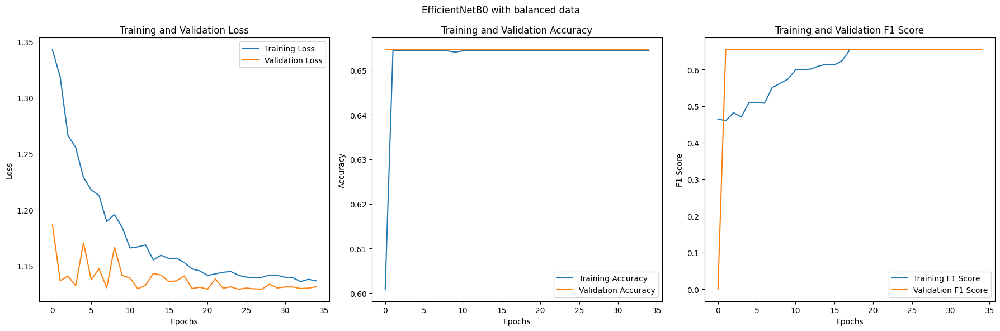

33/33 ━━━━━━━━━━━━━━━━━━━━ 6s 174ms/step - accuracy: 0.6596 - f1_score: 0.6596 - loss: 1.1199
Test loss: 1.1339507102966309
Test accuracy: 0.6541062593460083
Test F1 score: 0.6541061997413635
33/33 ━━━━━━━━━━━━━━━━━━━━ 13s 238ms/step
Predicted classes: [3 3 3 ... 3 3 3]
True classes: [0 3 3 ... 0 3 3]
Confusion Matrix:


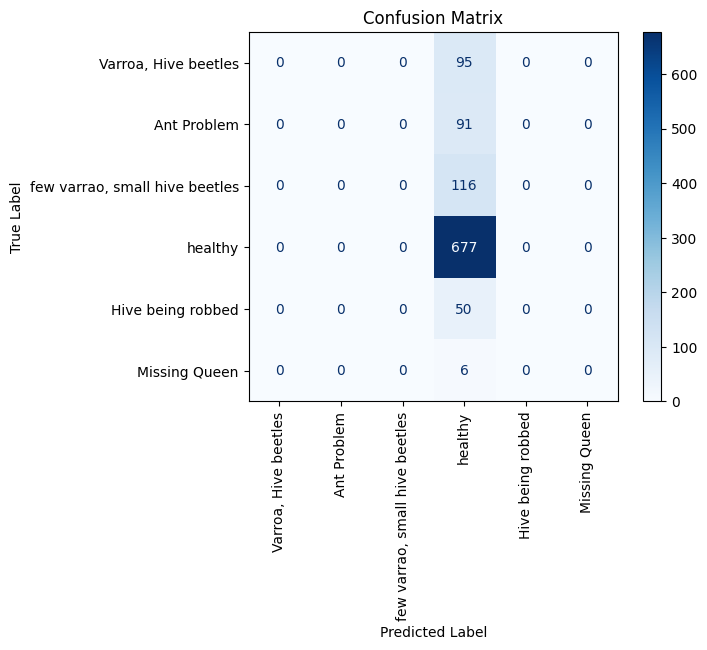

In [ ]:
# @title Efficient Net

efficient_base = tf.keras.applications.EfficientNetB0(weights='imagenet', include_top=False, input_shape=input_shape)
efficient_base.trainable = True

efficient_model, efficient_callbacks = build_model(base = efficient_base, dropout_rate=0.5, model_name='efficient_model.keras')

efficient_history = efficient_model.fit(X_train,y_train,
                                validation_data=(X_val,y_val),
                                epochs=50,
                                batch_size=32,
                                callbacks=efficient_callbacks,
                                verbose=1)

plot_training_history(efficient_history,"EfficientNetB0 with balanced data")
model_evaluation(X_test, y_test, efficient_model)


# Trainable models (balanced data)

<ipython-input-21-37e0f46fb694>:3: UserWarning: `input_shape` is undefined or non-square, or `rows` is not in [96, 128, 160, 192, 224]. Weights for input shape (224, 224) will be loaded as the default.
  mobilenet_base = tf.keras.applications.MobileNetV2(weights='imagenet', include_top=False, input_shape=input_shape)


Epoch 1/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 495ms/step - accuracy: 0.4561 - f1_score: 0.4041 - loss: 1.9715
Epoch 1: val_loss improved from inf to 5.36710, saving model to Mobile_model.keras
54/54 ━━━━━━━━━━━━━━━━━━━━ 91s 676ms/step - accuracy: 0.4582 - f1_score: 0.4065 - loss: 1.9597 - val_accuracy: 0.1990 - val_f1_score: 0.1995 - val_loss: 5.3671
Epoch 2/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - accuracy: 0.7990 - f1_score: 0.7883 - loss: 0.6016
Epoch 2: val_loss did not improve from 5.36710
54/54 ━━━━━━━━━━━━━━━━━━━━ 27s 40ms/step - accuracy: 0.7990 - f1_score: 0.7883 - loss: 0.6014 - val_accuracy: 0.2042 - val_f1_score: 0.2047 - val_loss: 6.7652
Epoch 3/50
53/54 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - accuracy: 0.8426 - f1_score: 0.8424 - loss: 0.4762
Epoch 3: val_loss improved from 5.36710 to 2.98562, saving model to Mobile_model.keras
54/54 ━━━━━━━━━━━━━━━━━━━━ 4s 71ms/step - accuracy: 0.8428 - f1_score: 0.8427 - loss: 0.4762 - val_accuracy: 0.3194 - val_f1_score: 0.2267 - val_loss: 

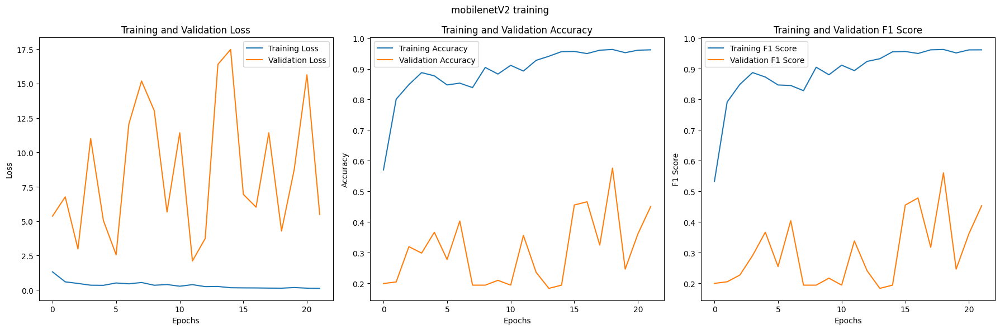

15/15 ━━━━━━━━━━━━━━━━━━━━ 2s 161ms/step - accuracy: 0.4254 - f1_score: 0.4277 - loss: 5.6714
Test loss: 5.659402847290039
Test accuracy: 0.428870290517807
Test F1 score: 0.4324893653392792
15/15 ━━━━━━━━━━━━━━━━━━━━ 7s 356ms/step
Predicted classes: [4 4 4 4 4 3 4 3 3 3 3 3 3 4 1 3 3 4 4 3 4 2 4 3 3 1 4 1 3 3 4 4 3 4 3 3 3
 4 3 4 3 4 4 4 4 3 4 4 3 4 3 4 4 3 3 3 1 4 4 1 3 4 3 4 3 4 4 4 3 2 4 3 1 2
 4 1 3 3 4 3 2 3 4 1 4 4 1 4 2 4 3 3 4 3 3 3 3 2 4 0 3 1 2 3 4 5 4 4 4 4 3
 4 3 3 4 4 3 3 2 1 1 3 4 4 3 4 3 3 4 2 1 1 4 3 4 1 3 1 3 4 3 3 4 4 4 2 4 3
 4 4 3 1 3 4 3 3 1 4 3 3 3 4 3 3 3 3 3 3 4 3 4 3 4 3 4 3 4 2 4 4 4 2 3 3 3
 3 4 2 3 1 3 1 2 4 3 1 3 1 4 2 4 1 3 3 1 2 4 4 3 4 4 3 4 0 3 4 4 4 4 3 4 4
 3 3 1 1 1 4 3 3 3 1 3 1 3 4 3 4 1 4 3 3 3 2 3 3 3 3 2 3 3 1 2 3 3 1 2 4 3
 4 4 3 3 4 3 4 4 3 4 4 3 4 3 4 4 4 3 3 3 4 4 3 3 4 4 3 3 3 1 3 4 4 2 3 4 1
 0 3 2 4 0 4 4 4 2 3 3 4 1 3 4 3 4 3 4 3 2 2 4 4 3 3 4 1 3 3 3 2 4 4 3 3 4
 1 3 4 4 3 3 4 3 3 4 4 4 3 3 4 3 4 4 3 3 3 4 4 3 4 3 4 3 3 3 3 0 1 3 2 3 3


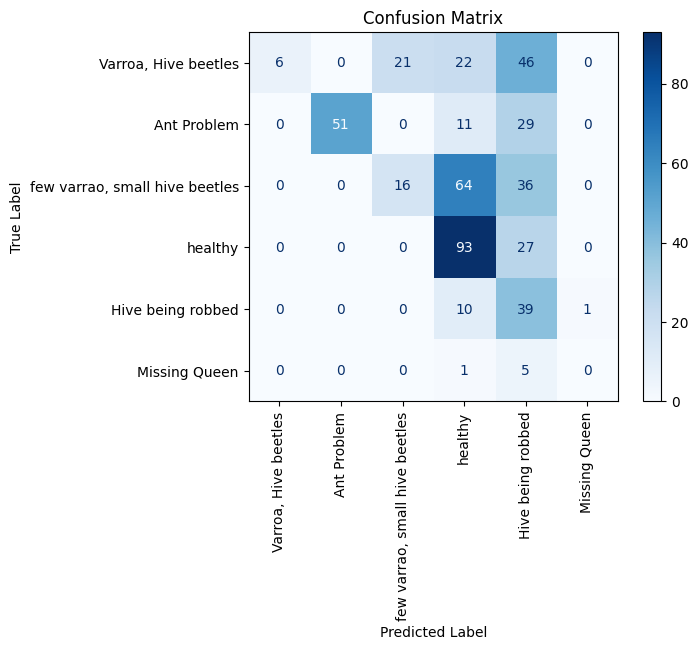

In [ ]:
# @title Mobilenet v2
input_shape = (img_width,img_height,img_channels)
mobilenet_base = tf.keras.applications.MobileNetV2(weights='imagenet', include_top=False, input_shape=input_shape)
mobilenet_base.trainable = True

mobile_model, mobile_callbacks = build_model(base=mobilenet_base,dropout_rate=0.5, model_name='Mobile_model.keras')

mobile_history = mobile_model.fit(X_train, y_train,
                                  validation_data=(X_val, y_val),
                                  epochs=50,
                                  batch_size=32,
                                  callbacks=mobile_callbacks,
                                  verbose=1)

plot_training_history(mobile_history,"mobilenetV2 training")
model_evaluation(X_test, y_test, mobile_model)


Epoch 1/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step - accuracy: 0.2254 - f1_score: 0.0580 - loss: 2.3360
Epoch 1: val_loss improved from inf to 1.32371, saving model to vgg16_model.keras
54/54 ━━━━━━━━━━━━━━━━━━━━ 36s 510ms/step - accuracy: 0.2264 - f1_score: 0.0582 - loss: 2.3271 - val_accuracy: 0.5340 - val_f1_score: 0.3089 - val_loss: 1.3237
Epoch 2/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step - accuracy: 0.4230 - f1_score: 0.2745 - loss: 1.3757
Epoch 2: val_loss improved from 1.32371 to 1.22480, saving model to vgg16_model.keras
54/54 ━━━━━━━━━━━━━━━━━━━━ 19s 160ms/step - accuracy: 0.4235 - f1_score: 0.2750 - loss: 1.3753 - val_accuracy: 0.4398 - val_f1_score: 0.2870 - val_loss: 1.2248
Epoch 3/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step - accuracy: 0.5480 - f1_score: 0.3966 - loss: 1.1468
Epoch 3: val_loss improved from 1.22480 to 1.04409, saving model to vgg16_model.keras
54/54 ━━━━━━━━━━━━━━━━━━━━ 8s 154ms/step - accuracy: 0.5478 - f1_score: 0.3971 - loss: 1.1468 - val_accuracy: 0

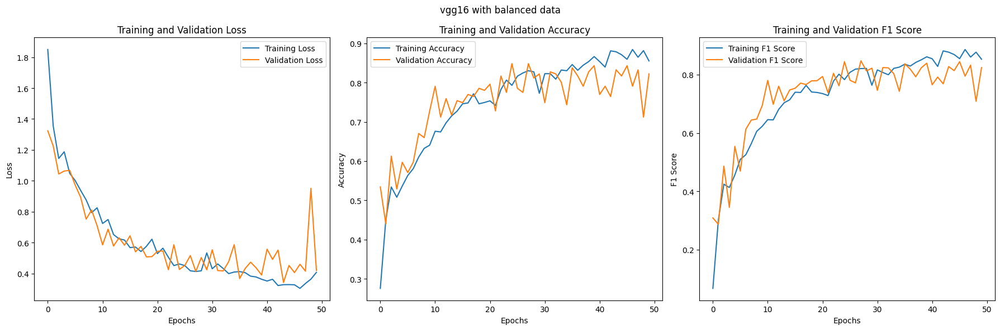

15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 73ms/step - accuracy: 0.8875 - f1_score: 0.8858 - loss: 0.2918
Test loss: 0.3326212763786316
Test accuracy: 0.8702929019927979
Test F1 score: 0.8691098690032959
15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 60ms/step
Predicted classes: [4 1 2 4 0 2 0 3 3 4 3 0 3 0 1 1 3 4 4 2 0 2 1 2 2 1 4 1 2 1 0 4 2 4 0 1 2
 4 3 1 3 0 4 3 2 3 4 0 3 3 2 3 2 2 2 2 1 0 0 1 0 3 3 3 3 3 4 3 2 2 3 2 1 2
 1 1 3 3 0 0 2 3 2 1 4 1 1 4 2 4 2 2 3 2 3 3 2 2 2 2 3 1 2 3 3 4 2 2 2 3 3
 1 2 2 2 1 2 0 2 1 1 3 1 2 0 1 3 0 0 0 1 1 1 3 2 1 3 1 2 1 0 3 3 1 2 2 0 3
 3 2 2 1 4 2 3 1 1 0 3 2 3 1 0 3 0 1 2 4 2 3 0 3 2 1 4 3 1 2 0 2 4 2 2 3 2
 3 0 0 3 1 2 1 2 4 0 1 3 1 2 2 4 1 2 2 1 2 4 1 3 0 4 3 3 2 2 3 2 1 1 3 4 3
 3 2 1 1 1 0 2 2 3 1 2 1 3 4 2 0 1 1 3 3 3 0 2 2 3 3 2 2 2 1 2 3 2 1 2 1 3
 3 4 3 3 0 2 0 3 3 2 3 2 2 3 2 2 1 3 3 0 2 2 2 3 4 2 4 2 3 1 3 2 2 2 4 0 1
 0 0 2 0 0 3 0 2 0 2 1 1 1 2 2 3 4 3 4 4 2 0 2 4 2 3 0 1 3 2 0 0 4 3 4 3 4
 1 3 2 2 2 2 3 2 3 2 2 0 3 3 2 2 4 0 1 2 2 0 2 2 3 3 3 1 2 2 3 0 1 3 2 2 0


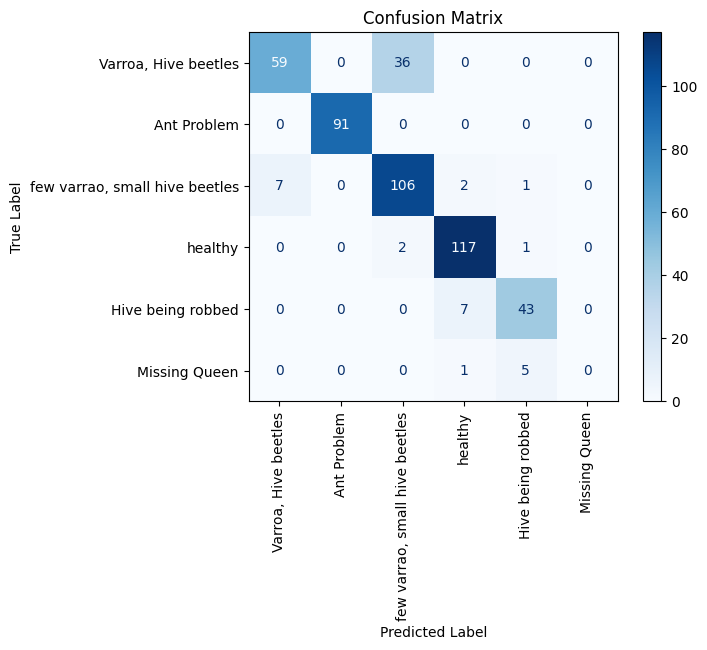

In [ ]:
# @title VGG 16

input_shape = (img_height, img_width, img_channels)
vgg16_base = tf.keras.applications.VGG16(weights='imagenet', include_top=False, input_shape=input_shape)
vgg16_base.trainable = True

vgg16_model, vgg16_callbacks = build_model(base=vgg16_base, dropout_rate=0.5, model_name='vgg16_model.keras')

vgg16_history = vgg16_model.fit(X_train,y_train,
                                validation_data=(X_val,y_val),
                                epochs=50,
                                batch_size=32,
                                callbacks=vgg16_callbacks,
                                verbose=1)

plot_training_history(vgg16_history,"vgg16 with balanced data")
model_evaluation(X_test, y_test, vgg16_model)

Epoch 1/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 622ms/step - accuracy: 0.5120 - f1_score: 0.4719 - loss: 2.3847
Epoch 1: val_loss improved from inf to 32.02159, saving model to resnet_model.keras
54/54 ━━━━━━━━━━━━━━━━━━━━ 113s 972ms/step - accuracy: 0.5138 - f1_score: 0.4739 - loss: 2.3666 - val_accuracy: 0.1937 - val_f1_score: 0.1937 - val_loss: 32.0216
Epoch 2/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step - accuracy: 0.6913 - f1_score: 0.6743 - loss: 0.8070
Epoch 2: val_loss improved from 32.02159 to 6.39741, saving model to resnet_model.keras
54/54 ━━━━━━━━━━━━━━━━━━━━ 27s 395ms/step - accuracy: 0.6917 - f1_score: 0.6747 - loss: 0.8108 - val_accuracy: 0.2408 - val_f1_score: 0.2408 - val_loss: 6.3974
Epoch 3/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step - accuracy: 0.7098 - f1_score: 0.7037 - loss: 0.7332
Epoch 3: val_loss improved from 6.39741 to 3.69861, saving model to resnet_model.keras
54/54 ━━━━━━━━━━━━━━━━━━━━ 47s 500ms/step - accuracy: 0.7097 - f1_score: 0.7037 - loss: 0.7336 - val_accu

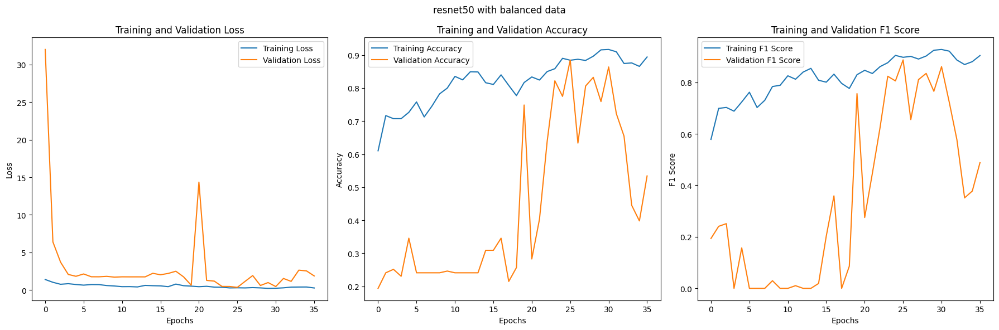

15/15 ━━━━━━━━━━━━━━━━━━━━ 2s 148ms/step - accuracy: 0.5784 - f1_score: 0.5346 - loss: 1.7276
Test loss: 1.6544184684753418
Test accuracy: 0.5774058699607849
Test F1 score: 0.537530243396759
15/15 ━━━━━━━━━━━━━━━━━━━━ 7s 252ms/step
Predicted classes: [4 3 2 4 2 3 2 3 3 4 3 3 3 2 1 3 3 4 4 3 3 2 1 2 2 3 1 1 2 3 2 3 3 3 3 1 3
 4 3 3 3 2 3 3 2 3 3 2 3 3 2 2 2 2 2 2 3 2 3 1 2 3 3 3 3 3 3 3 3 2 3 3 3 2
 3 1 3 3 2 2 2 3 3 1 4 1 1 5 2 3 2 2 3 3 3 3 2 2 3 3 3 1 2 3 3 3 2 2 3 3 3
 3 2 2 3 1 2 2 3 1 1 3 3 3 2 3 3 2 2 2 1 1 3 3 2 1 3 1 3 3 2 3 3 1 1 2 2 3
 4 2 3 3 3 3 3 1 1 2 3 3 3 3 2 3 2 1 2 3 3 3 2 3 2 3 4 3 1 2 2 2 4 2 2 3 2
 3 2 2 3 1 2 1 3 3 2 1 3 3 3 2 4 1 2 2 1 2 3 3 3 2 3 3 3 3 2 3 2 1 1 3 4 3
 3 2 3 1 1 2 2 3 3 3 3 1 3 4 2 2 3 1 3 3 3 2 2 3 3 3 2 3 3 1 2 3 2 1 3 1 3
 3 3 3 3 2 3 2 3 3 3 3 2 2 3 3 3 1 3 3 2 2 2 3 2 4 2 3 2 3 1 3 3 2 2 4 2 1
 2 3 2 2 2 3 1 2 2 2 3 1 3 2 2 3 3 3 3 3 3 2 3 4 3 3 2 1 3 3 3 2 4 3 3 3 4
 1 3 3 2 3 2 3 2 3 2 2 2 3 3 2 2 4 3 1 2 3 2 3 2 3 3 3 3 2 2 3 2 1 3 2 2 2

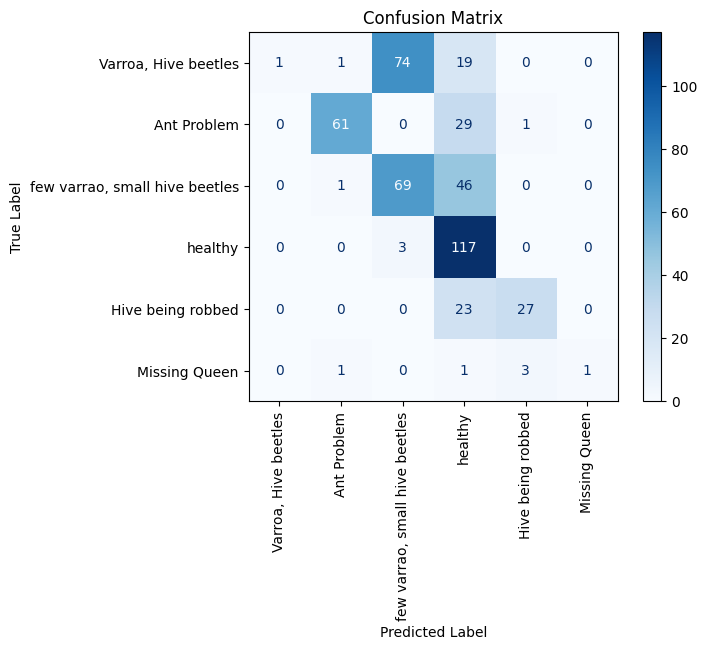

In [ ]:
# @title ResNet50

resnet_base = tf.keras.applications.ResNet50(weights='imagenet', include_top=False, input_shape=input_shape)
resnet_base.trainable = True

resnet_model, resnet_callbacks = build_model(base = resnet_base, dropout_rate=0.5, model_name='resnet_model.keras')

resnet_history = resnet_model.fit(X_train,y_train,
                                validation_data=(X_val,y_val),
                                epochs=50,
                                batch_size=32,
                                callbacks=resnet_callbacks,
                                verbose=1)

plot_training_history(resnet_history,"resnet50 with balanced data")
model_evaluation(X_test, y_test, resnet_model)

Epoch 1/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 897ms/step - accuracy: 0.5109 - f1_score: 0.4851 - loss: 1.5106
Epoch 1: val_loss improved from inf to 3.60053, saving model to efficient_model.keras
54/54 ━━━━━━━━━━━━━━━━━━━━ 151s 1s/step - accuracy: 0.5138 - f1_score: 0.4883 - loss: 1.5000 - val_accuracy: 0.2513 - val_f1_score: 0.2513 - val_loss: 3.6005
Epoch 2/50
53/54 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step - accuracy: 0.8504 - f1_score: 0.8539 - loss: 0.3937
Epoch 2: val_loss did not improve from 3.60053
54/54 ━━━━━━━━━━━━━━━━━━━━ 42s 47ms/step - accuracy: 0.8507 - f1_score: 0.8541 - loss: 0.3933 - val_accuracy: 0.2408 - val_f1_score: 0.2408 - val_loss: 4.3274
Epoch 3/50
53/54 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - accuracy: 0.8872 - f1_score: 0.8862 - loss: 0.3749
Epoch 3: val_loss improved from 3.60053 to 2.97240, saving model to efficient_model.keras
54/54 ━━━━━━━━━━━━━━━━━━━━ 11s 159ms/step - accuracy: 0.8870 - f1_score: 0.8861 - loss: 0.3738 - val_accuracy: 0.2408 - val_f1_score: 0.2408 - val_

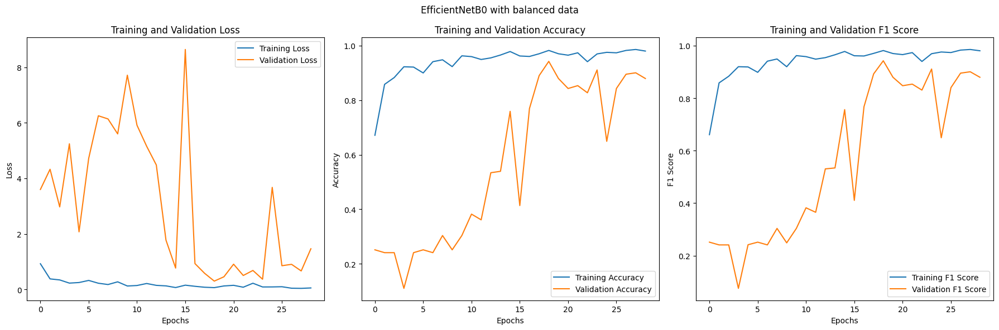

15/15 ━━━━━━━━━━━━━━━━━━━━ 3s 239ms/step - accuracy: 0.8901 - f1_score: 0.8913 - loss: 0.6282
Test loss: 0.9042526483535767
Test accuracy: 0.8912134170532227
Test F1 score: 0.8930816650390625
15/15 ━━━━━━━━━━━━━━━━━━━━ 12s 480ms/step
Predicted classes: [4 1 2 4 0 2 2 3 2 4 3 0 3 0 1 1 3 4 4 2 2 2 1 2 2 1 4 1 2 1 2 4 2 4 2 1 2
 4 3 1 3 0 4 3 0 3 4 2 3 3 2 3 3 2 2 2 1 0 2 1 0 3 3 3 3 3 4 3 2 2 0 2 1 2
 1 1 3 3 0 0 2 3 2 1 4 1 1 5 2 4 2 2 2 2 3 3 2 2 2 0 3 1 2 3 3 4 0 2 2 3 3
 1 2 2 2 1 2 0 2 1 1 3 1 2 0 1 3 2 0 0 1 1 1 3 0 1 3 1 2 1 2 3 3 1 2 2 0 3
 4 2 2 1 3 2 2 1 1 2 3 2 3 1 0 3 0 1 2 4 2 3 0 3 0 1 4 3 1 2 0 0 4 2 2 3 2
 3 0 2 3 1 2 1 0 4 2 1 3 1 4 2 4 1 2 2 1 2 4 1 3 0 4 3 3 0 2 4 2 1 1 3 4 3
 3 2 1 1 1 2 2 2 3 1 2 1 3 4 2 0 1 1 3 3 3 2 2 2 3 3 0 2 2 1 2 3 2 1 2 1 3
 3 4 3 3 2 2 0 3 3 2 3 2 2 2 2 2 1 2 3 2 3 0 2 3 4 2 4 2 3 1 3 2 2 2 4 2 1
 0 0 2 0 0 3 2 2 2 2 1 1 1 2 2 3 4 3 4 4 0 2 0 4 2 3 0 1 3 2 0 0 4 3 4 3 4
 1 3 2 2 0 2 3 2 3 2 0 0 3 3 2 2 4 0 1 2 2 0 2 2 4 3 3 1 2 2 3 0 1 3 2 2

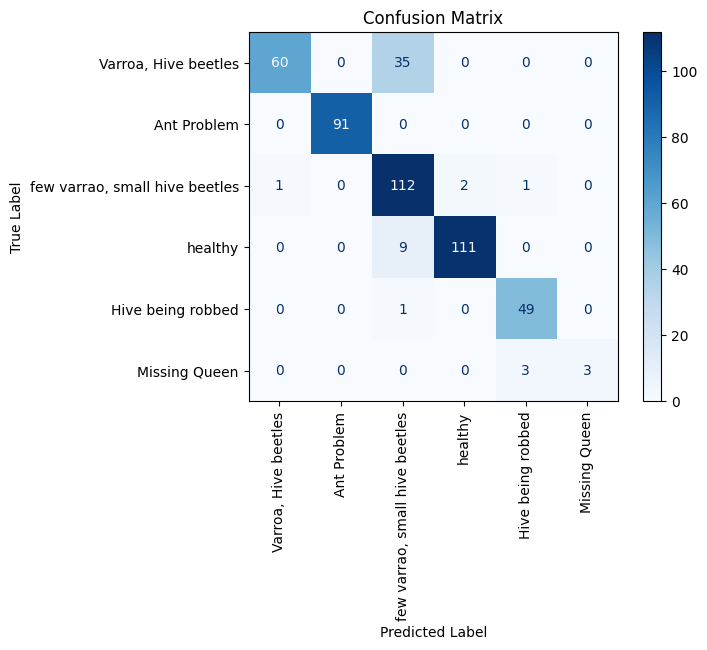

In [ ]:
# @title Efficient Net

efficient_base = tf.keras.applications.EfficientNetB0(weights='imagenet', include_top=False, input_shape=input_shape)
efficient_base.trainable = True

efficient_model, efficient_callbacks = build_model(base = efficient_base, dropout_rate=0.5, model_name='efficient_model.keras')

efficient_history = efficient_model.fit(X_train,y_train,
                                validation_data=(X_val,y_val),
                                epochs=50,
                                batch_size=32,
                                callbacks=efficient_callbacks,
                                verbose=1)

plot_training_history(efficient_history,"EfficientNetB0 with balanced data")
model_evaluation(X_test, y_test, efficient_model)
